In [35]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

sns.set_context('notebook', font_scale=1.5, rc={'lines.markeredgewidth': 2})
sns.set_style('white', {'axes.spines.right': False, 'axes.spines.top': False, 'xtick.bottom': True, 'ytick.left': True,})
sns.set_palette('deep')

In [36]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [37]:
import openscope_predictive_coding as opc

In [38]:
from openscope_predictive_coding.ophys.dataset.openscope_predictive_coding_dataset import OpenScopePredictiveCodingDataset
from openscope_predictive_coding.ophys.response_analysis.response_analysis import ResponseAnalysis

In [39]:
import openscope_predictive_coding.ophys.plotting.experiment_summary_figures as esf
import openscope_predictive_coding.ophys.plotting.summary_figures as sf

import openscope_predictive_coding.ophys.response_analysis.utilities as ut

In [40]:
cache_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis'

In [193]:
manifest_file = os.path.join(cache_dir, 'opc_production_manifest.xlsx')

In [194]:
data = pd.read_excel(manifest_file)

In [195]:
data = data[data['experiment_state']=='passed']

In [196]:
print('total mice:', len(data['mouse_id'].unique()))
print('# V1 injections:', len(data[data['injection_area']=='VISp']['mouse_id'].unique()))
print('# RSP injections:', len(data[data['injection_area']=='RSP']['mouse_id'].unique()))
print('# V1 imaging sessions:', len(data[data['imaging_area']=='VISp']['experiment_id'].unique()))
print('# RSP imaging sessions:', len(data[data['imaging_area']=='RSP']['experiment_id'].unique()))
print('# PM imaging sessions:', len(data[data['imaging_area']=='VISpm']['experiment_id'].unique()))

total mice: 12
# V1 injections: 5
# RSP injections: 7
# V1 imaging sessions: 14
# RSP imaging sessions: 10
# PM imaging sessions: 22


In [197]:
expt_ids = data.experiment_id.unique()
expt_ids = np.sort([int(e) for e in expt_ids if np.isnan(e) == False])
print(expt_ids)

[768898762 775058863 775613721 776727982 813071318 816795279 817251851
 818894752 826576489 827232898 827235482 828956958 828959377 829411383
 829417358 830075254 830688059 830688102 831312165 831314921 832107135
 832601977 832617299 833599179 833611925 833612445 833614835 833626456
 834244626 834251985 834260382 835642229 835654507 835660148 836246273
 836248932 836250018 836253258 836890936 836891984 836906598 837283374
 837285285 837287590 837630919 838330377]


### get example expt

In [198]:
dataset = OpenScopePredictiveCodingDataset(expt_ids[1], cache_dir)
analysis = ResponseAnalysis(dataset, preload_response_dfs=False)

In [199]:
sequence_images = analysis.get_sequence_images()
oddball_images = analysis.get_oddball_images()
images = analysis.get_image_ids()

In [200]:
sequence_colors = sns.color_palette("Blues", len(sequence_images))
oddball_colors = sns.color_palette("Reds", len(oddball_images))

### load multi session dfs

In [201]:
cache_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis'

In [202]:
oddball_df = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'mean_oddball_df_events.h5'))

In [203]:
transitions_df = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'mean_transition_control_df_events.h5'))

In [204]:
occlusion_df = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'mean_occlusion_df_events.h5'))

In [205]:
pre_df = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'mean_randomized_control_pre_df_events.h5'))
# post_df = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'mean_randomized_control_post_df_events.h5'))
# nmdf = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'mean_natural_movie_one_df.h5'))


In [206]:
odf = oddball_df.copy()
ocdf = occlusion_df.copy()
tdf = transitions_df.copy()

In [207]:
cell_specimen_ids = odf.cell_specimen_id.unique()

#### merge with injection target

In [ ]:
def get_manifest(cache_dir=None): 
    """
    Loads experiment manifest file as a dataframe, listing all experiments and associated metadata
    """
    if cache_dir is None: 
        cache_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis'
    manifest_file = os.path.join(cache_dir, 'opc_production_manifest.xlsx')
    manifest = pd.read_excel(manifest_file)
    return manifest

In [227]:
def add_projection_pathway_to_df(df, cache_dir=None):
    """
    df: dataframe to add projection pathway information to. Dataframe must have a column 'experiment_id'.
    cache_dir: cache directory to load manifest from 
    
    Adds columns called 'injection_area', the brain area where the retrograde tracer was injected, 
    and 'projection_pathway', indicating whether retrogradely labeled cells are part of a feed forward ('FF') or feed back ('FB') pathway,
    to experiment manifest table, then merges in with provided dataframe. 
    """
    manifest = get_manifest(cache_dir)
    manifest['projection_pathway'] = np.nan
    manifest.at[manifest[manifest.injection_area=='RSP'].index.values, 'projection_pathway'] = 'FF'
    manifest.at[manifest[manifest.injection_area=='VISp'].index.values, 'projection_pathway'] = 'FB'
    manifest.at[manifest[(manifest.imaging_area=='VISpm')&(manifest.injection_area=='RSP')].index.values, 'projection_pathway'] = 'FF'
    manifest.at[manifest[(manifest.imaging_area=='VISpm')&(manifest.injection_area=='VISp')].index.values, 'projection_pathway'] = 'FB'
    df = df.merge(manifest[['experiment_id','injection_area','pathway']], on='experiment_id')
    return data

In [228]:
odf = odf.merge(data[['experiment_id','injection_area','pathway']], on='experiment_id')
ocdf = ocdf.merge(data[['experiment_id','injection_area','pathway']], on='experiment_id')
tdf = tdf.merge(data[['experiment_id','injection_area','pathway']], on='experiment_id')
pre_df = pre_df.merge(data[['experiment_id','injection_area','pathway']], on='experiment_id')

#### annotate dfs

In [59]:
def add_location_to_df(df):
    """
    Add useful columns, including 'depth' which translates 'imaging_depth' integer values in um to a string indicating superficial or deep layers, 
    and 'location', a string combining the imaged area and the 'depth' string as a way to easily group data by both area and depth for analysis.
    """
    df['area'] = df.targeted_structure.values
    df['depth'] = ['deep' if depth > 250 else 'superficial' for depth in df.imaging_depth.values]
    df['location'] = None
    df['location'] = [df.iloc[row].area+'_'+df.iloc[row].depth for row in range(len(df))]
    return df

In [60]:
# odf = add_location_to_df(odf)
# ocdf = add_location_to_df(ocdf)
# tdf = add_location_to_df(tdf)

In [61]:
# pre_df = add_location_to_df(pre_df)
# post_df = add_location_to_df(post_df)
# nmdf = add_location_to_df(nmdf)

In [62]:
def add_retrogradely_labeled_column_to_df(df):
    """
    takes any dataframe with a column for 'cell_specimen_id' and adds a new column called 'retrogradely_labeled' which is a boolean for whether the cell was tagged or not
    """
    cache_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis'
    cache_dir = r'C:\Users\marinag\Dropbox\opc_analysis'
    red_label_df = pd.read_hdf(os.path.join(cache_dir, 'multi_session_summary_dfs', 'red_label_df.h5'), key='df')
    red_label_df.reset_index(inplace=True)
    red_label_df['cell_specimen_id'] = [int(cell_specimen_id) for cell_specimen_id in red_label_df.cell_specimen_id.values]
    red_df = red_label_df[['cell_specimen_id', 'retrogradely_labeled']]
    df = pd.merge(df, red_df, left_on='cell_specimen_id', right_on='cell_specimen_id')
    return df

In [63]:
# odf = add_retrogradely_labeled_column_to_df(odf)
# ocdf = add_retrogradely_labeled_column_to_df(ocdf)
# tdf = add_retrogradely_labeled_column_to_df(tdf)

In [64]:
# pre_df = add_retrogradely_labeled_column_to_df(pre_df)
# # post_df = add_retrogradely_labeled_column_to_df(post_df)
# nmdf = add_retrogradely_labeled_column_to_df(nmdf)

In [65]:
odf.keys()

Index(['cell_specimen_id', 'image_id', 'oddball', 'mean_response',
       'sem_response', 'mean_trace', 'sem_trace', 'pref_stim',
       'fraction_significant_trials', 'fraction_responsive_trials',
       'experiment_id', 'experiment_container_id', 'targeted_structure',
       'imaging_depth', 'cre_line', 'reporter_line', 'full_genotype',
       'session_type', 'donor_id', 'experiment_date', 'specimen_id', 'depth',
       'location', 'session_num', 'area', 'retrogradely_labeled'],
      dtype='object')

### validate fraction responsive

In [66]:
def plot_mean_trace_with_variability(traces, frame_rate, ylabel='dF/F', label=None, color='k', interval_sec=1,
                                     xlims=[-4, 4], ax=None):
#     xlim = [xlims[0] + np.abs(xlims[0]), xlims[1] + np.abs(xlims[0])]
    if ax is None:
        fig, ax = plt.subplots()
    if len(traces) > 0:
        mean_trace = np.mean(traces, axis=0)
        times = np.arange(0, len(mean_trace), 1)
        sem = (traces.std()) / np.sqrt(float(len(traces)))
        for trace in traces:
            ax.plot(trace, linewidth=1, color='gray')
        ax.plot(mean_trace, label=label, linewidth=3, color=color, zorder=100)
        xticks, xticklabels = sf.get_xticks_xticklabels(mean_trace, frame_rate, interval_sec, window=xlims)
        ax.set_xticks(xticks)
        ax.set_xticklabels([int(x) for x in xticklabels])
        ax.set_xlim(0,(np.abs(xlims[0])+xlims[1]) * int(frame_rate))
        ax.set_xlabel('time (sec)')
        ax.set_ylabel(ylabel)
        sns.despine(ax=ax)
    return ax

In [261]:
dataset = OpenScopePredictiveCodingDataset(expt_ids[1], cache_dir)
analysis = ResponseAnalysis(dataset, regenerate_dfs=True, use_events=True)

In [282]:
tmp = analysis.get_response_df('oddball')

generating df for oddball
generating response dataframe for oddball _events


In [283]:
tmp.keys()

Index(['stimulus_presentations_id', 'cell_specimen_id', 'trace',
       'trace_timestamps', 'mean_response', 'baseline_response',
       'summed_response', 'p_value', 'index', 'sweep', 'start_frame',
       'end_frame_inclusive', 'start_time', 'end_time', 'session_block_name',
       'image_id', 'repeat', 'fraction_occlusion', 'duration', 'session_type',
       'stimulus_key', 'data_file_index', 'data_file_name', 'frame_list',
       'mean_running_speed', 'oddball', 'sequence_start',
       'violation_sequence'],
      dtype='object')

### plot for one

In [79]:
save_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis\summary_figures'
image_ids = sequence_images+oddball_images

experiment_id = expt_ids[0]
print(experiment_id)
dataset = OpenScopePredictiveCodingDataset(experiment_id, cache_dir)
analysis = ResponseAnalysis(dataset, preload_response_dfs=False, use_events=True)
oddball_df = analysis.get_response_df('oddball')
transition_df = analysis.get_response_df('transition_control')
cell_specimen_ids = dataset.get_cell_specimen_ids()
meta = dataset.metadata

768898762
no response dataframe file for oddball - generating
generating response dataframe for oddball _events
loading response dataframe for transition_control


### plot mean response

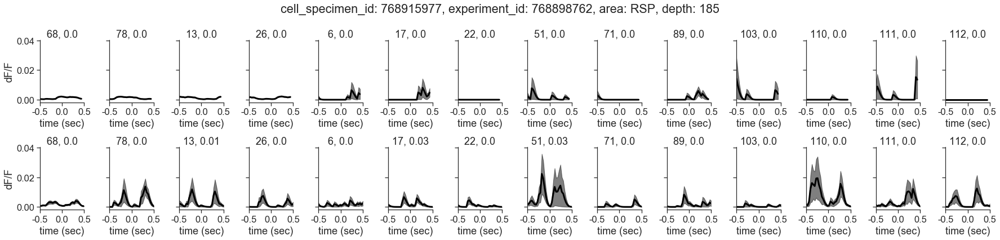

In [95]:
cell_specimen_id = cell_specimen_ids[10] 
figsize = (25,6)
fig, ax = plt.subplots(2, len(image_ids), figsize=figsize, sharey=True)
ax = ax.ravel()
for i,image_id in enumerate(image_ids): 
    df = oddball_df[(oddball_df.cell_specimen_id==cell_specimen_id)&(oddball_df.image_id==image_id)]
    ax[i] = sf.plot_mean_trace(df.trace.values, 31., ylabel='dF/F', legend_label=None, color='k', interval_sec=0.5,
                                         xlims=[-0.5, 0.5], ax=ax[i])
    fraction_sig_trials = odf[(odf.cell_specimen_id==cell_specimen_id)&(odf.image_id==image_id)].fraction_significant_trials.values[0]
    ax[i].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
    ax[i].set_ylabel('')
    ax[i].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')

    df = transition_df[(transition_df.cell_specimen_id==cell_specimen_id)&(transition_df.image_id==image_id)&(transition_df.second_in_sequence==True)]
    ax[i+len(image_ids)] = sf.plot_mean_trace(df.trace.values, 31., ylabel='dF/F', legend_label=None, color='k', interval_sec=0.5,
                                         xlims=[-0.5, 0.5], ax=ax[i+len(image_ids)])
    fraction_sig_trials = tdf[(tdf.cell_specimen_id==cell_specimen_id)&(tdf.image_id==image_id)].fraction_significant_trials.values[0]
    ax[i+len(image_ids)].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
    ax[i+len(image_ids)].set_ylabel('')
    ax[i+len(image_ids)].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')  

ax[0].set_ylabel('dF/F')
ax[len(image_ids)].set_ylabel('dF/F')
fig.tight_layout()
plt.gcf().subplots_adjust(top=0.85)
title = 'cell_specimen_id: '+str(cell_specimen_id)+', experiment_id: '+str(meta.ophys_experiment_id.values[0])+', area: '+str(meta.targeted_structure.values[0]+', depth: '+str(meta.imaging_depth.values[0]))
plt.suptitle(title, x=0.5, y=1.0, horizontalalignment='center')
fig_title = str(meta.ophys_experiment_id.values[0])+'_'+str(cell_specimen_id)+'_'+str(meta.targeted_structure.values[0]+'_'+str(meta.imaging_depth.values[0]))                                                                                                          
sf.save_figure(fig, figsize, save_dir, 'mean_response_oddball_transition_events', str(cell_specimen_id))
# plt.close()

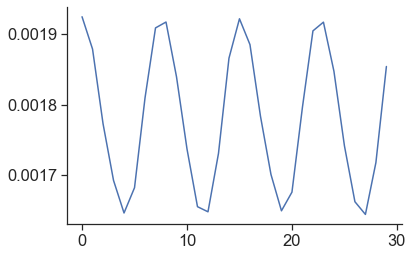

In [81]:
plt.plot(oddball_df.trace.mean())

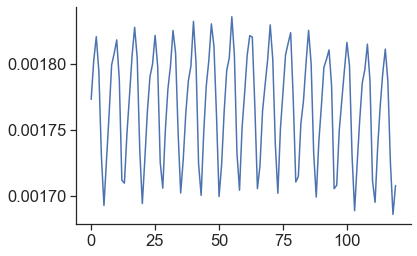

In [82]:
plt.plot(transition_df.trace.mean())

### plot for all 

In [ ]:
# save_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis\summary_figures'
# image_ids = sequence_images+oddball_images

# for experiment_id in expt_ids: 
#     print(experiment_id)
#     dataset = OpenScopePredictiveCodingDataset(experiment_id, cache_dir)
#     analysis = ResponseAnalysis(dataset, preload_response_dfs=False)
#     oddball_df = analysis.get_response_df('oddball')
#     transition_df = analysis.get_response_df('transition_control')
#     cell_specimen_ids = dataset.get_cell_specimen_ids()
#     meta = dataset.metadata

#     for cell_specimen_id in cell_specimen_ids: 
#         figsize = (25,6)
#         fig, ax = plt.subplots(2, len(image_ids), figsize=figsize, sharey=True)
#         ax = ax.ravel()
#         for i,image_id in enumerate(image_ids): 
#             df = oddball_df[(oddball_df.cell_specimen_id==cell_specimen_id)&(oddball_df.image_id==image_id)]
#             ax[i] = sf.plot_mean_trace(df.dff_trace.values, 31., ylabel='dF/F', legend_label=None, color='k', interval_sec=1,
#                                                  xlims=[-2, 2], ax=ax[i])
#             fraction_sig_trials = odf[(odf.cell_specimen_id==cell_specimen_id)&(odf.image_id==image_id)].fraction_significant_trials.values[0]
#             ax[i].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
#             ax[i].set_ylabel('')
#             ax[i].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')

#             df = transition_df[(transition_df.cell_specimen_id==cell_specimen_id)&(transition_df.image_id==image_id)&(transition_df.second_in_sequence==True)]
#             ax[i+len(image_ids)] = sf.plot_mean_trace(df.dff_trace.values, 31., ylabel='dF/F', legend_label=None, color='k', interval_sec=1,
#                                                  xlims=[-2, 2], ax=ax[i+len(image_ids)])
#             fraction_sig_trials = tdf[(tdf.cell_specimen_id==cell_specimen_id)&(tdf.image_id==image_id)].fraction_significant_trials.values[0]
#             ax[i+len(image_ids)].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
#             ax[i+len(image_ids)].set_ylabel('')
#             ax[i+len(image_ids)].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')  

#         ax[0].set_ylabel('dF/F')
#         ax[len(image_ids)].set_ylabel('dF/F')
#         fig.tight_layout()
#         plt.gcf().subplots_adjust(top=0.85)
#         title = 'cell_specimen_id: '+str(cell_specimen_id)+', experiment_id: '+str(meta.ophys_experiment_id.values[0])+', area: '+str(meta.targeted_structure.values[0]+', depth: '+str(meta.imaging_depth.values[0]))
#         plt.suptitle(title, x=0.5, y=1.0, horizontalalignment='center')
#         fig_title = str(meta.ophys_experiment_id.values[0])+'_'+str(cell_specimen_id)+'_'+str(meta.targeted_structure.values[0]+'_'+str(meta.imaging_depth.values[0]))                                                                                                          
#         sf.save_figure(fig, figsize, save_dir, 'mean_response_oddball_transition', fig_title)
#         plt.close()

### plot variability

### for one

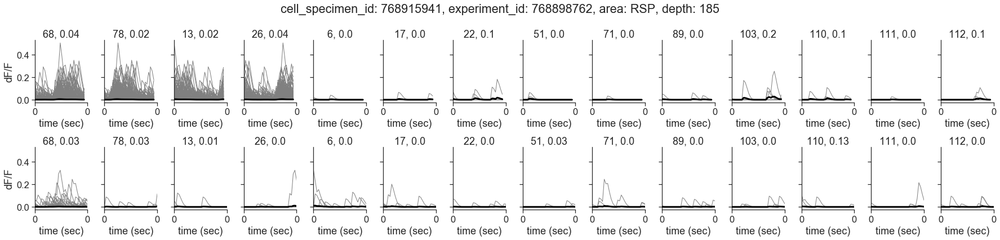

In [100]:
cell_specimen_id = cell_specimen_ids[0] 
figsize = (25,6)
fig, ax = plt.subplots(2, len(image_ids), figsize=figsize, sharey=True)
ax = ax.ravel()
for i,image_id in enumerate(image_ids): 
    df = oddball_df[(oddball_df.cell_specimen_id==cell_specimen_id)&(oddball_df.image_id==image_id)]
    ax[i] = plot_mean_trace_with_variability(df.trace.values, 31., ylabel='dF/F', label=None, color='k', interval_sec=1,
                                         xlims=[-0.5, 0.5], ax=ax[i])
    fraction_sig_trials = odf[(odf.cell_specimen_id==cell_specimen_id)&(odf.image_id==image_id)].fraction_significant_trials.values[0]
    ax[i].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
    ax[i].set_ylabel('')
    ax[i].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')

    df = transition_df[(transition_df.cell_specimen_id==cell_specimen_id)&(transition_df.image_id==image_id)&(transition_df.second_in_sequence==True)]
    ax[i+len(image_ids)] = plot_mean_trace_with_variability(df.trace.values, 31., ylabel='dF/F', label=None, color='k', interval_sec=1,
                                         xlims=[-0.5, 0.5], ax=ax[i+len(image_ids)])
    fraction_sig_trials = tdf[(tdf.cell_specimen_id==cell_specimen_id)&(tdf.image_id==image_id)].fraction_significant_trials.values[0]
    ax[i+len(image_ids)].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
    ax[i+len(image_ids)].set_ylabel('')
    ax[i+len(image_ids)].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')  

ax[0].set_ylabel('dF/F')
ax[len(image_ids)].set_ylabel('dF/F')
fig.tight_layout()
plt.gcf().subplots_adjust(top=0.85)
title = 'cell_specimen_id: '+str(cell_specimen_id)+', experiment_id: '+str(meta.ophys_experiment_id.values[0])+', area: '+str(meta.targeted_structure.values[0]+', depth: '+str(meta.imaging_depth.values[0]))
plt.suptitle(title, x=0.5, y=1.0, horizontalalignment='center')
fig_title = str(meta.ophys_experiment_id.values[0])+'_'+str(cell_specimen_id)+'_'+str(meta.targeted_structure.values[0])+'_'+str(meta.imaging_depth.values[0])                                                                                                          
sf.save_figure(fig, figsize, save_dir, 'variability_events', fig_title)
# plt.close()

### plot for all 

In [ ]:
# save_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis\summary_figures'
# image_ids = sequence_images+oddball_images

# for experiment_id in expt_ids: 
#     print(experiment_id)
#     dataset = OpenScopePredictiveCodingDataset(experiment_id, cache_dir)
#     analysis = ResponseAnalysis(dataset, preload_response_dfs=False)
#     oddball_df = analysis.get_response_df('oddball')
#     transition_df = analysis.get_response_df('transition_control')
#     cell_specimen_ids = dataset.get_cell_specimen_ids()
#     meta = dataset.metadata

#     for cell_specimen_id in cell_specimen_ids: 
#         figsize = (25,6)
#         fig, ax = plt.subplots(2, len(image_ids), figsize=figsize, sharey=True)
#         ax = ax.ravel()
#         for i,image_id in enumerate(image_ids): 
#             df = oddball_df[(oddball_df.cell_specimen_id==cell_specimen_id)&(oddball_df.image_id==image_id)]
#             ax[i] = plot_mean_trace_with_variability(df.dff_trace.values, 31., ylabel='dF/F', label=None, color='k', interval_sec=1,
#                                                  xlims=[-2, 2], ax=ax[i])
#             fraction_sig_trials = odf[(odf.cell_specimen_id==cell_specimen_id)&(odf.image_id==image_id)].fraction_significant_trials.values[0]
#             ax[i].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
#             ax[i].set_ylabel('')
#             ax[i].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')

#             df = transition_df[(transition_df.cell_specimen_id==cell_specimen_id)&(transition_df.image_id==image_id)&(transition_df.second_in_sequence==True)]
#             ax[i+len(image_ids)] = plot_mean_trace_with_variability(df.dff_trace.values, 31., ylabel='dF/F', label=None, color='k', interval_sec=1,
#                                                  xlims=[-2, 2], ax=ax[i+len(image_ids)])
#             fraction_sig_trials = tdf[(tdf.cell_specimen_id==cell_specimen_id)&(tdf.image_id==image_id)].fraction_significant_trials.values[0]
#             ax[i+len(image_ids)].set_title(str(int(image_id))+', '+str(np.round(fraction_sig_trials,2)))
#             ax[i+len(image_ids)].set_ylabel('')
#             ax[i+len(image_ids)].axvline(x=2*31, ymin=0, ymax=1, color=sns.color_palette()[0], linestyle='--')  

#         ax[0].set_ylabel('dF/F')
#         ax[len(image_ids)].set_ylabel('dF/F')
#         fig.tight_layout()
#         plt.gcf().subplots_adjust(top=0.85)
#         title = 'cell_specimen_id: '+str(cell_specimen_id)+', experiment_id: '+str(meta.ophys_experiment_id.values[0])+', area: '+str(meta.targeted_structure.values[0]+', depth: '+str(meta.imaging_depth.values[0]))
#         plt.suptitle(title, x=0.5, y=1.0, horizontalalignment='center')
#         fig_title = str(meta.ophys_experiment_id.values[0])+'_'+str(cell_specimen_id)+'_'+str(meta.targeted_structure.values[0]+'_'+str(meta.imaging_depth.values[0])                                                                                                          
#         sf.save_figure(fig, figsize, save_dir, 'variability', fig_title)
#         plt.close()

### population averages for different conditions 

In [217]:
def get_xticks_xticklabels(trace, frame_rate, interval_sec=1, window=[-2,2]):
    """
    Function that accepts a timeseries, evaluates the number of points in the trace, and converts from acquisition frames to timestamps

    :param trace: a single trace where length = the number of timepoints
    :param frame_rate: ophys frame rate if plotting a calcium trace, stimulus frame rate if plotting running speed
    :param interval_sec: interval in seconds in between labels

    :return: xticks, xticklabels = xticks in frames corresponding to timepoints in the trace, xticklabels in seconds
    """
    interval_frames = interval_sec * frame_rate
    n_frames = len(trace)
    n_sec = n_frames / frame_rate
    xticks = np.arange(0, n_frames + 5, interval_frames)
    xticklabels = np.arange(0, n_sec + 0.1, interval_sec)
    xticklabels = xticklabels + window[0]
    if interval_sec >= 1:
        xticklabels = [int(x) for x in xticklabels]
    return xticks, xticklabels


In [218]:

def plot_response_across_conditions_population(df, condition='area', conditions=['VISp', 'VISpm', 'RSP'],
                                               window=[-2, 2], save_figures=False, colors=None, autoscale=False,
                                               title='',save_dir=None, folder=None, ax=None, pref_stim=False, frame_rate=31.):
    if pref_stim:
        df = df[df.pref_stim == True].copy()
    if ax is None:
        figsize = (5, 5)
        fig, ax = plt.subplots(figsize=figsize)
    for c, condition_value in enumerate(conditions):
        tmp = df[df[condition] == condition_value]
        if colors is None:
            colors = sns.color_palette()
        traces = tmp.mean_trace.values
        trace = np.mean(traces, axis=0)
        ax = sf.plot_mean_trace(traces, frame_rate, legend_label=condition_value, color=colors[c],
                                interval_sec=0.5, xlims=window, ax=ax)
        
    ax.axvspan(np.abs(window[0])*frame_rate, (np.abs(window[0])+0.25)*frame_rate, 
               facecolor='gray', edgecolor='none', alpha=0.7, linewidth=0, zorder=1)
    
#     ax = plot_flashes_on_trace(ax, flashes=False, alpha=0.15, window=window, omitted=True)
    
    xticks, xticklabels = get_xticks_xticklabels(trace, 31., interval_sec=1, window=window)
    ax.set_xticks(xticks)
    ax.set_xticklabels([int(x) for x in xticklabels])
    #     ax.set_xlim(0,(np.abs(window[0])+window[1])*31.)
    ax.legend(bbox_to_anchor=(1.1, 1), title=condition)
    if not autoscale:
        ymin, ymax = ax.get_ylim()
        if ymin > 0:
            ax.set_ylim(0, ymax * 1.2)
        else:
            ax.set_ylim(ymin * 1.2, ymax * 1.2)
    ax.set_title(title)
    if save_figures:
        fig.tight_layout()
        save_figure(fig, figsize, save_dir, folder, 'population_response_across_' + condition + '_' + cre_line)
    return ax


In [219]:
areas = ['VISp','VISpm','RSP']

In [220]:
odf['expected'] = np.nan

In [221]:
expected_image = analysis.get_sequence_images()[3]
oddball_images = analysis.get_oddball_images()

In [222]:
expected_list = []
for image_id in odf.image_id.values: 
    if image_id == expected_image: 
        expected_list.append(True)
    elif image_id in oddball_images:
        expected_list.append(False)
    else: 
        expected_list.append(np.nan)
odf['expected'] = expected_list

In [223]:
odf.expected.unique()

array([False, nan, True], dtype=object)

In [108]:
odf[['image_id', 'oddball', 'expected']]

,image_id,oddball,expected
0,6.0,True,False
1,13.0,False,NaN
2,17.0,True,False
3,22.0,True,False
4,26.0,False,True
...,...,...,...
90589,89.0,True,False
90590,103.0,True,False
90591,110.0,True,False
90592,111.0,True,False


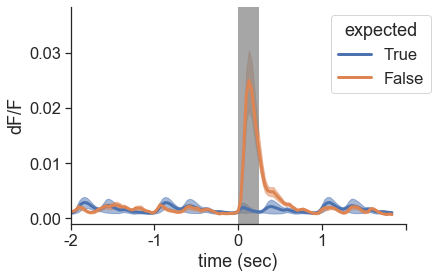

In [109]:
experiment_id = 828956958
fig, ax = plt.subplots()
df = odf[(odf.experiment_id==experiment_id)].copy()
plot_response_across_conditions_population(df, condition='expected', conditions=[True, False],
                                                   window=[-2, 2], ax=ax)

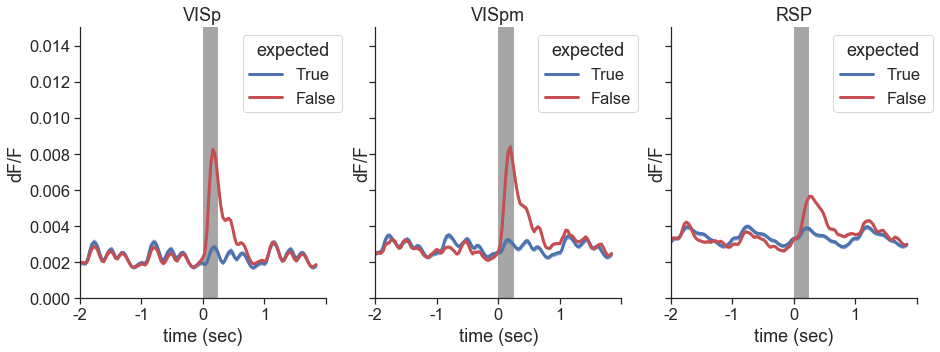

In [110]:
c = sns.color_palette()
colors = [c[0], c[3]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='expected', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)

Text(0.5, 0.98, 'retrogradely labeled')

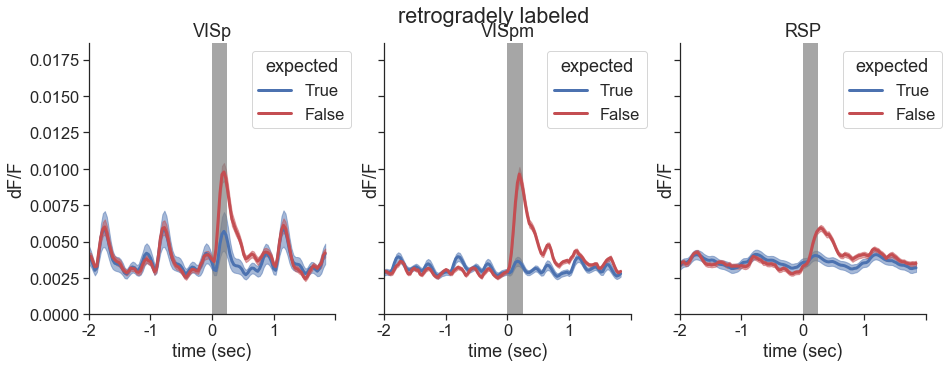

In [111]:
c = sns.color_palette()
colors = [c[0], c[3]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.retrogradely_labeled==True)].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='expected', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('retrogradely labeled')

Text(0.5, 0.98, 'not retrogradely labeled')

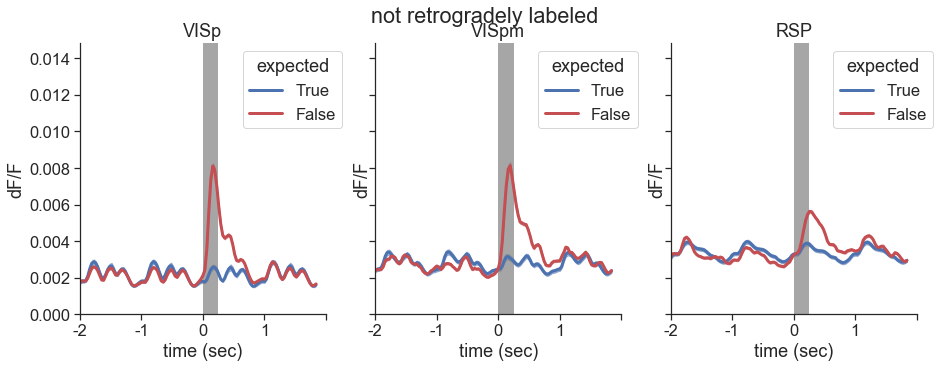

In [112]:
c = sns.color_palette()
colors = [c[0], c[3]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.retrogradely_labeled==False)].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='expected', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('not retrogradely labeled')

In [1]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.oddball==True)].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='retrogradely_labeled', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('oddball response')

NameError: name 'sns' is not defined

Text(0.5, 0.98, 'first image in sequence - image A')

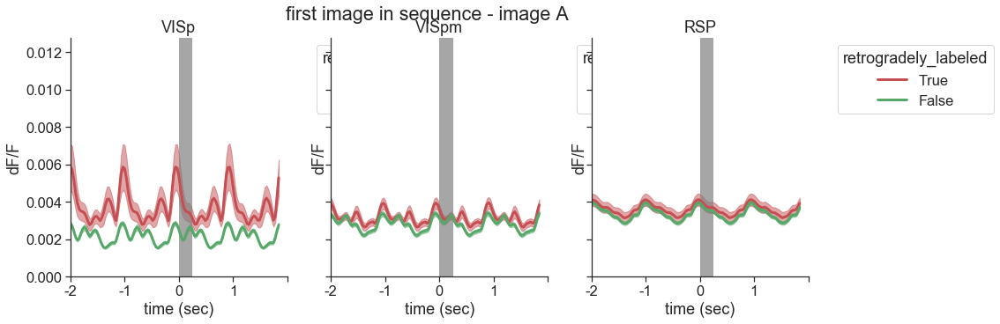

In [130]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.oddball==False)&(odf.image_id==sequence_images[0])].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='retrogradely_labeled', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('first image in sequence - image A')

Text(0.5, 0.98, 'expected sequence image - image D')

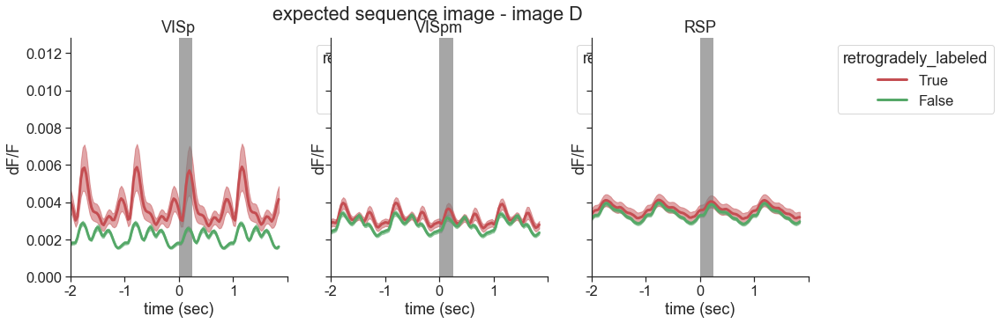

In [131]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.image_id==sequence_images[3])].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='retrogradely_labeled', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('expected sequence image - image D')

In [231]:
odf.pathway.unique()

array(['FB', 'FF'], dtype=object)

Text(0.5, 0.98, 'oddball images')

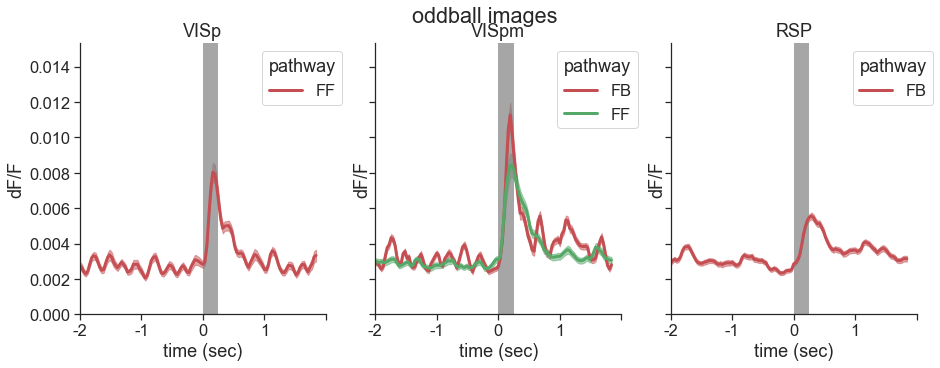

In [241]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.oddball==True)&(odf.retrogradely_labeled==True)].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='pathway', conditions=df.pathway.unique(),
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('oddball images - retrogradely labeled')

Text(0.5, 0.98, 'oddball images - not labeled')

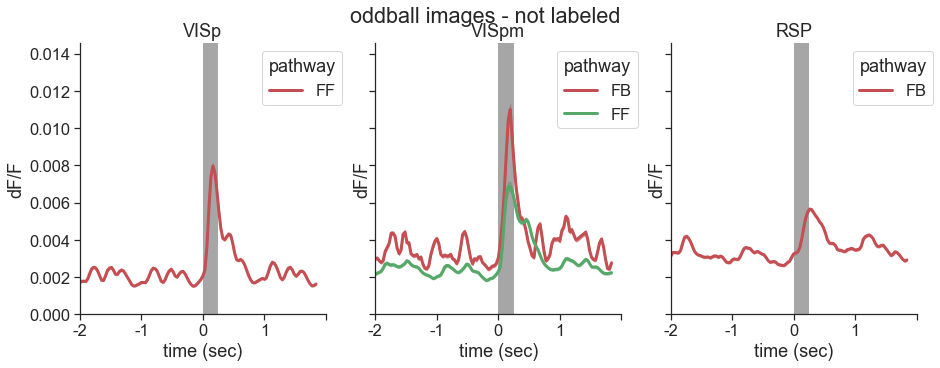

In [242]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.oddball==True)&(odf.retrogradely_labeled==False)].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='pathway', conditions=df.pathway.unique(),
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('oddball images - not labeled')

Text(0.5, 0.98, 'expected sequence image - image D')

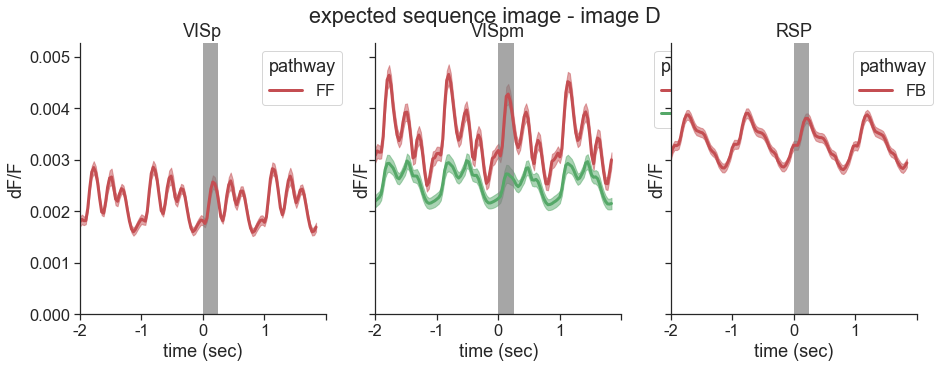

In [239]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.image_id==sequence_images[3])].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='pathway', conditions=df.pathway.unique(),
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('expected sequence image - image D')

### single cells 

In [137]:
from openscope_predictive_coding.ophys.plotting import population_summary_figures as psf

In [ ]:
c = sns.color_palette()
colors = [c[3], c[2]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.oddball==False)&(odf.image_id==sequence_images[0])&()].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='retrogradely_labeled', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('first image in sequence - image A')

In [149]:
cdf.keys()

Index(['cell_specimen_id', 'image_id', 'oddball', 'mean_response',
       'sem_response', 'mean_trace', 'sem_trace', 'pref_stim',
       'fraction_significant_trials', 'fraction_responsive_trials',
       'experiment_id', 'experiment_container_id', 'targeted_structure',
       'imaging_depth', 'cre_line', 'reporter_line', 'full_genotype',
       'session_type', 'donor_id', 'experiment_date', 'specimen_id', 'depth',
       'location', 'session_num', 'area', 'retrogradely_labeled', 'expected'],
      dtype='object')

C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



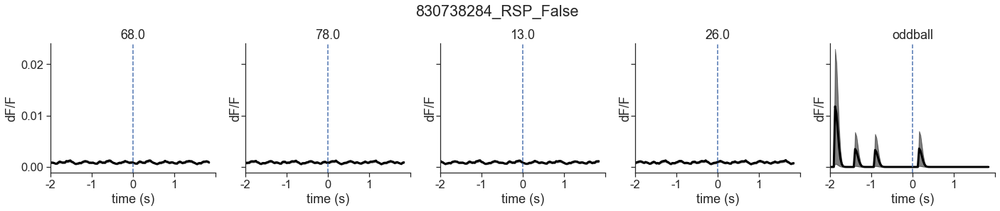

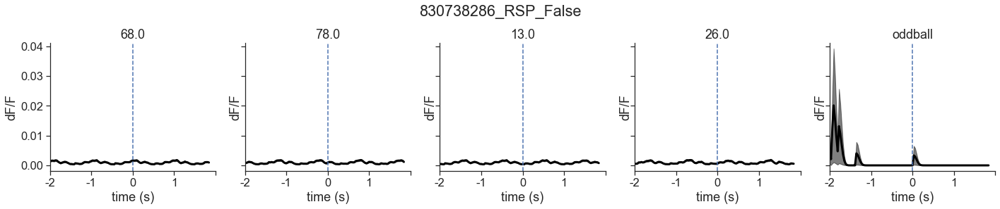

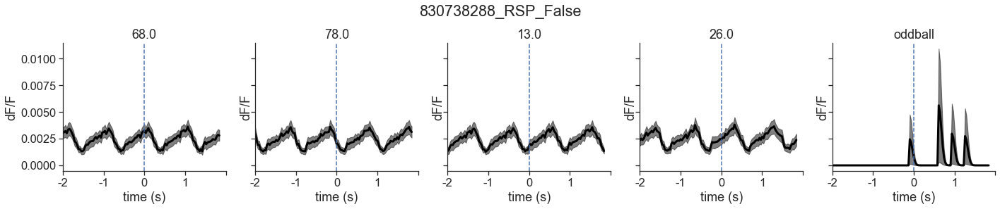

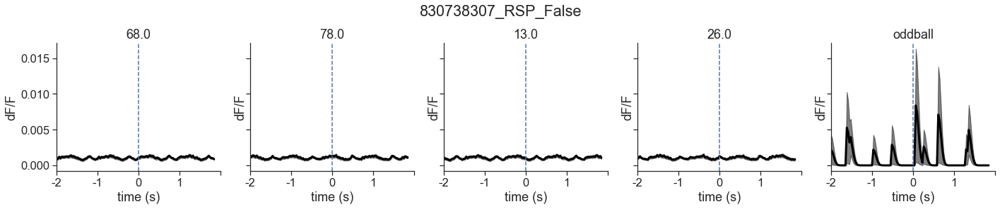

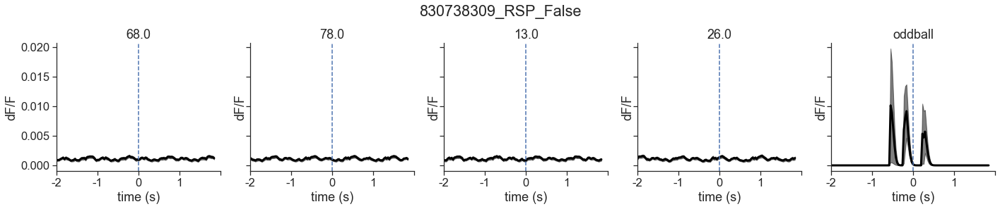

...

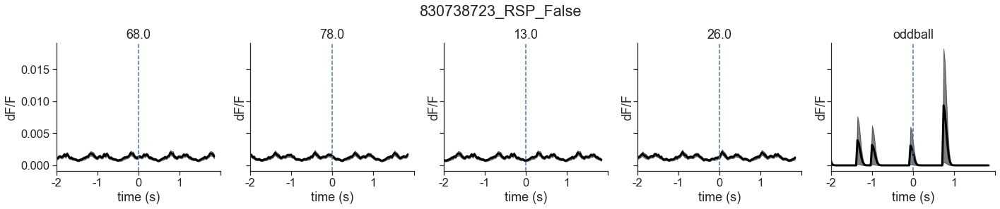

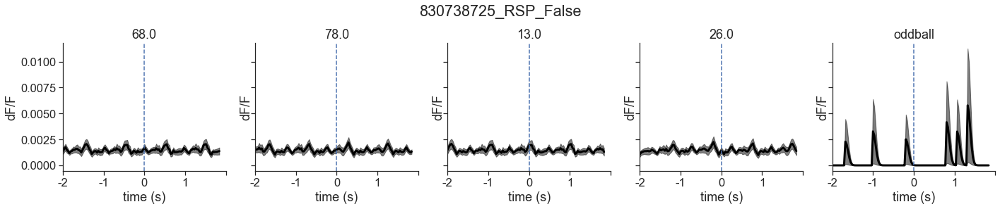

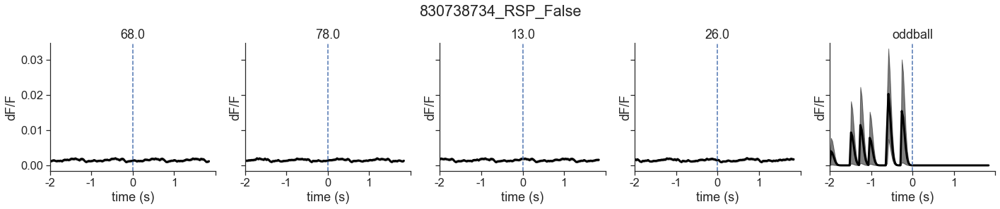

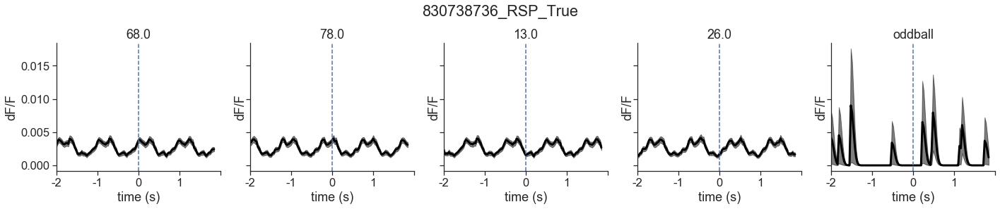

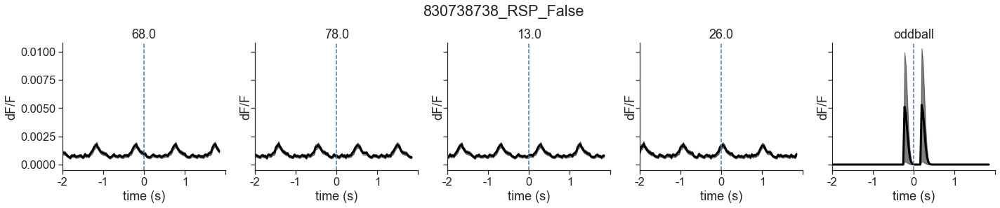

In [157]:
for cell_specimen_id in odf[(odf.targeted_structure=='RSP')&(odf.experiment_id==830688102)].cell_specimen_id.unique():
    figsize = (20,4)
    fig, ax = plt.subplots(1,5, figsize=figsize, sharey=True)
    ax = ax.ravel()
    cdf = odf[odf.cell_specimen_id==cell_specimen_id]

    for i, sequence_image in enumerate(sequence_images): 
        df = cdf[(cdf.image_id==sequence_image)].copy()
        psf.plot_mean_trace_from_mean_df(df, ax=ax[i], xlims=[-2,2])
        ax[i].axvline(x=31*2, linestyle='--')
        ax[i].set_title(sequence_image)

    i+=1
    df = cdf[(cdf.oddball==True)].copy()
    psf.plot_mean_trace_from_mean_df(df, ax=ax[i], xlims=[-2,2])
    ax[i].set_title('oddball')
    ax[i].axvline(x=31*2, linestyle='--')

    plt.suptitle(str(cdf.cell_specimen_id.values[0])+'_'+cdf.targeted_structure.values[0]+'_'+str(cdf.retrogradely_labeled.values[0]),x=0.5, y=1.05)
    fig.tight_layout()

C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



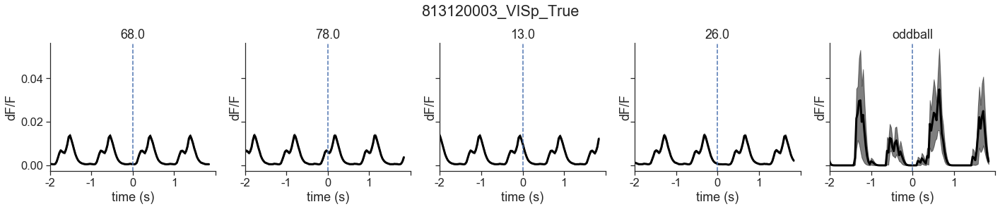

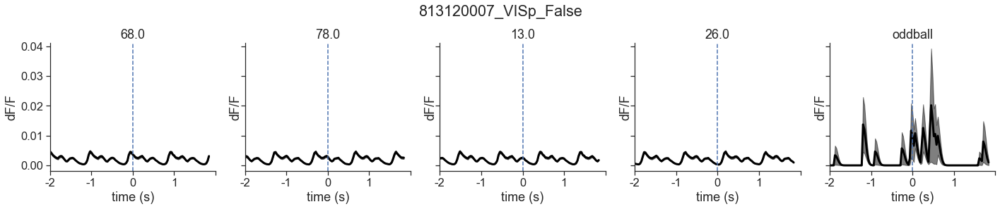

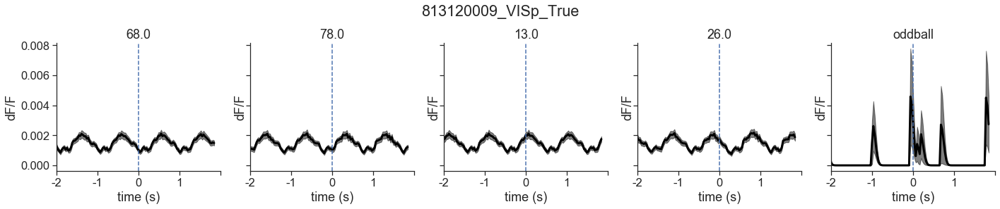

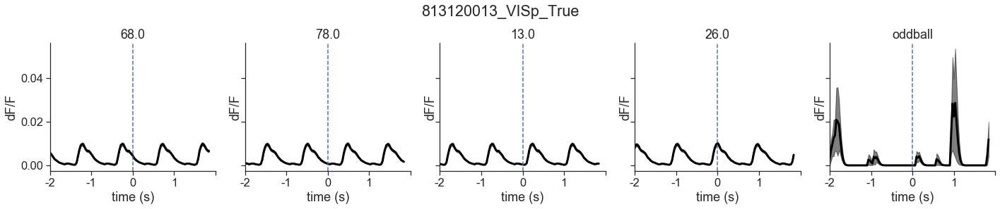

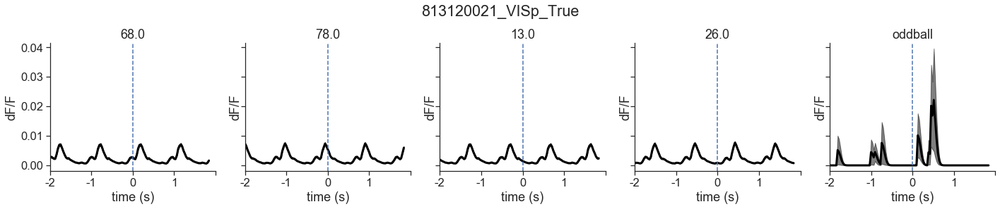

...

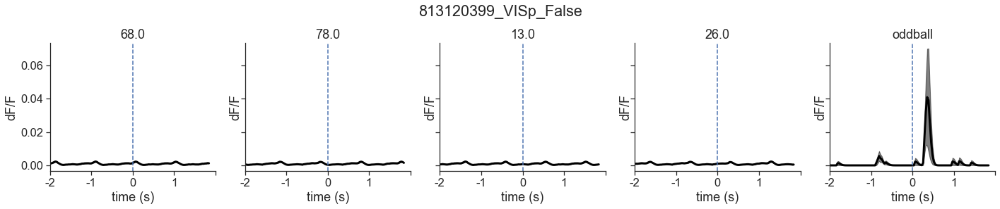

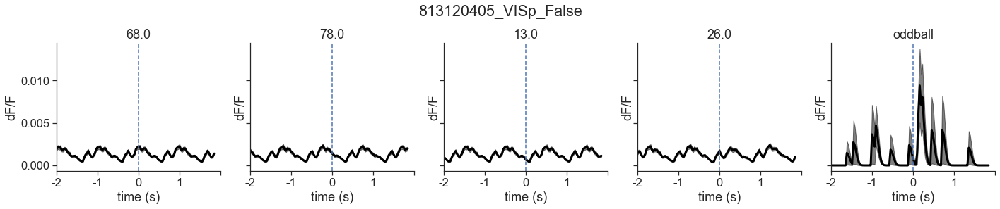

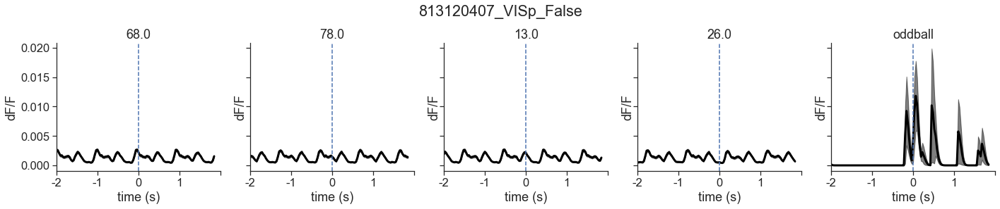

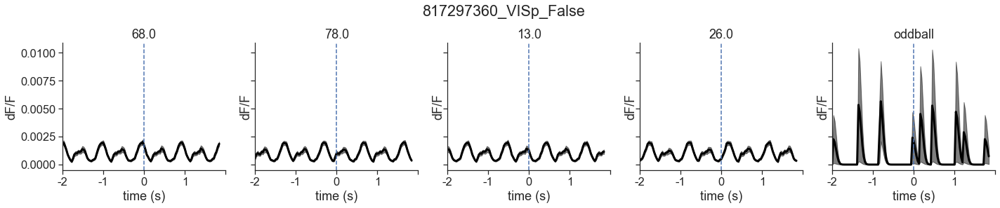

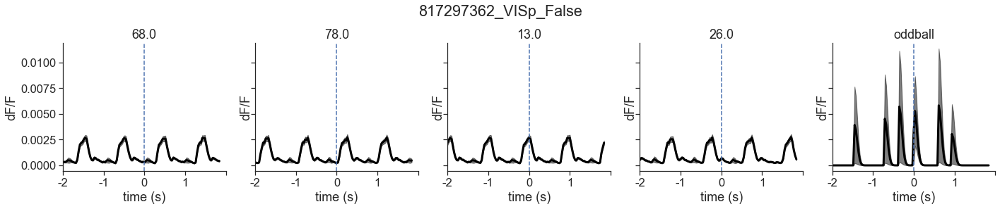

In [158]:
for cell_specimen_id in odf[(odf.targeted_structure=='VISp')].cell_specimen_id.unique()[:100]:
    figsize = (20,4)
    fig, ax = plt.subplots(1,5, figsize=figsize, sharey=True)
    ax = ax.ravel()
    cdf = odf[odf.cell_specimen_id==cell_specimen_id]

    for i, sequence_image in enumerate(sequence_images): 
        df = cdf[(cdf.image_id==sequence_image)].copy()
        psf.plot_mean_trace_from_mean_df(df, ax=ax[i], xlims=[-2,2])
        ax[i].axvline(x=31*2, linestyle='--')
        ax[i].set_title(sequence_image)

    i+=1
    df = cdf[(cdf.oddball==True)].copy()
    psf.plot_mean_trace_from_mean_df(df, ax=ax[i], xlims=[-2,2])
    ax[i].set_title('oddball')
    ax[i].axvline(x=31*2, linestyle='--')

    plt.suptitle(str(cdf.cell_specimen_id.values[0])+'_'+cdf.targeted_structure.values[0]+'_'+str(cdf.retrogradely_labeled.values[0]),x=0.5, y=1.05)
    fig.tight_layout()

### heatmaps

In [323]:
def reannotate_pref_stim(df):
    m = df.copy()
    m['pref_stim'] = False
    for cell in m.cell_specimen_id.values:
        cdf = m[m.cell_specimen_id==cell]
        image_index = np.where(cdf['mean_response'].values == np.max(cdf['mean_response'].values))[0][0]
        pref_image = cdf['mean_response'].index[image_index]
        rows = df[(df.cell_specimen_id == cell) & (df.image_id == pref_image)].index
        for trial in trials:
            df.loc[rows, 'pref_stim'] = True
    return df

In [326]:
def plot_mean_image_responses(df, image_ids, vmax=0.03, colorbar=False, ax=None, save_dir=None, folder=None, use_events=True,
                               interval_sec=1, window=[-2,2]):
    if use_events:
#         vmax = 0.003
        label = 'mean event magnitude'
        suffix = '_events'
    else:
        # vmax = 0.3
        label = 'mean dF/F'
        suffix = ''
    experiment_id = df.experiment_id.unique()[0]
    imaging_area = df.area.unique()[0]
    
    
    df = reannotate_pref_stim(df[df.image_id.isin(image_ids)])
    
    figsize = (25,10)
    cells = []
    for image_id in image_ids:
        tmp = df[(df.image_id == image_id) & (df.pref_stim == True)]
        order = np.argsort(tmp.mean_response.values)[::-1]
        cell_ids = list(tmp.cell_specimen_id.values[order])
        cells = cells + cell_ids
    if ax is None:
        fig, ax = plt.subplots(1, len(image_ids), figsize=figsize, sharey=True, sharex=True)
        ax = ax.ravel()
    for i, image_id in enumerate(image_ids):
        im_df = df[(df.image_id == image_id)]
        len_trace = len(im_df.mean_trace.values[0])
        response_array = np.empty((len(cells), len_trace))
        for x, cell in enumerate(cells):
            tmp = im_df[im_df.cell_specimen_id == cell]
            if len(tmp) >= 1:
                trace = tmp.mean_trace.values[0]
            else:
                trace = np.empty((len_trace))
                trace[:] = np.nan
            response_array[x, :] = trace
        sns.heatmap(data=response_array, vmin=0, vmax=vmax, ax=ax[i], cmap='magma', cbar=colorbar,
                    cbar_kws={'label': label})
        xticks, xticklabels = sf.get_xticks_xticklabels(trace, 31., interval_sec=interval_sec, window=window)
        ax[i].set_xticks(xticks)
        if interval_sec < 1:
            ax[i].set_xticklabels(xticklabels)
        else:
            ax[i].set_xticklabels([int(x) for x in xticklabels])
        if response_array.shape[0] > 300:
            interval = 500
        else:
            interval = 50
        ax[i].set_xlim(0, (np.abs(window[0])+window[1])*31.)
        ax[i].set_yticks(np.arange(0, response_array.shape[0], interval))
        ax[i].set_yticklabels(np.arange(0, response_array.shape[0], interval))
        ax[i].set_xlabel('time (sec)', fontsize=16)
        ax[i].set_title(str(int(image_id)))
        ax[0].set_ylabel('cells')
    plt.suptitle(str(experiment_id)+', '+imaging_area, x=0.52, y=.98, fontsize=18, horizontalalignment='center')
    fig.tight_layout()
    plt.gcf().subplots_adjust(top=0.85)
#     if save_dir:
#         save_figure(fig, figsize, save_dir, folder,
#                     'change_response_matrix_' + cre_line + '_' + image_set + '_' + suffix)



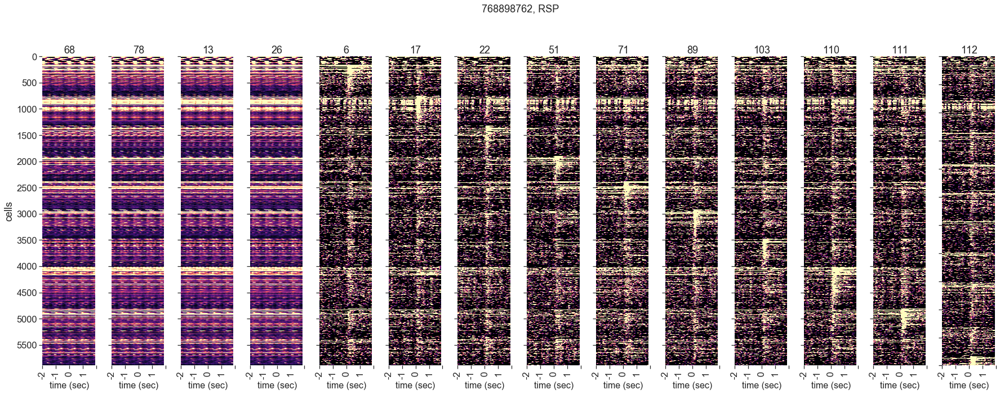

In [316]:
image_ids = sequence_images+oddball_images
plot_mean_image_responses(odf, image_ids, vmax=0.005, colorbar=False, ax=None, save_dir=None, folder=None, use_events=True,
                               interval_sec=1, window=[-2,2])

In [327]:
plot_mean_image_responses(odf[odf.area==area], image_ids, vmax=0.008, colorbar=False, ax=None, save_dir=None, folder=None, use_events=True,
                               interval_sec=1, window=[-2,2])

KeyError: 'trace'

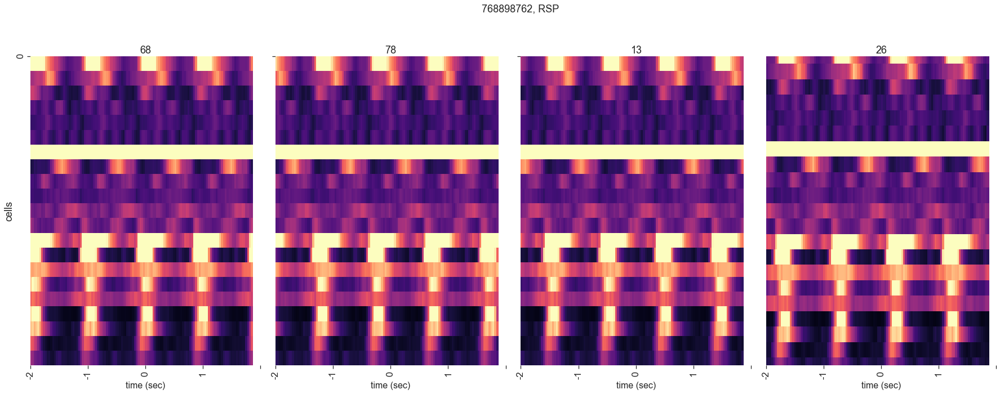

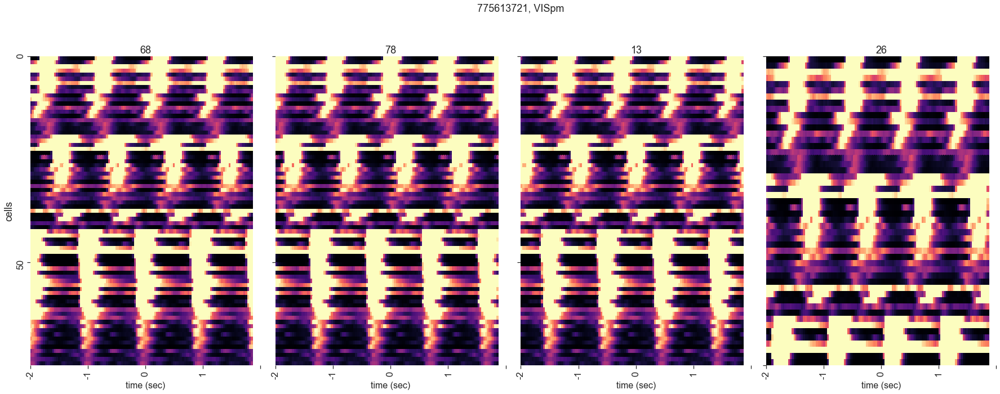

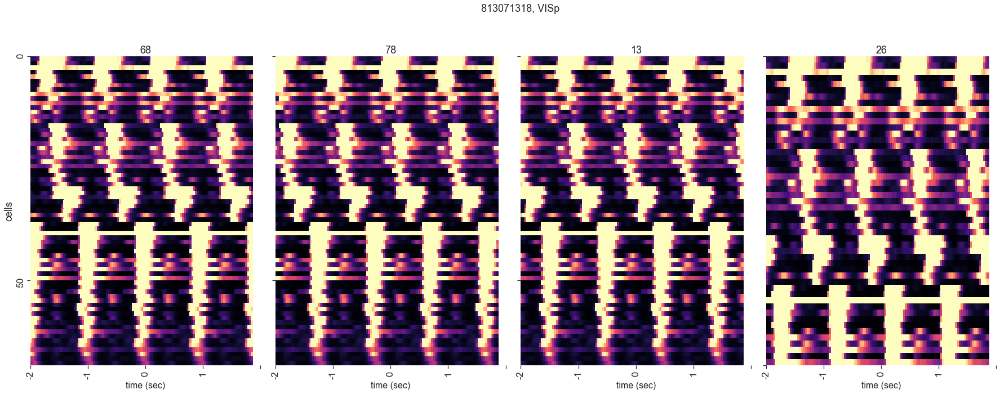

In [322]:
image_ids = sequence_images
for area in odf.area.unique():
    plot_mean_image_responses(odf[odf.area==area], image_ids, vmax=0.008, colorbar=False, ax=None, save_dir=None, folder=None, use_events=True,
                               interval_sec=1, window=[-2,2])

C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



775058863


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



830688059


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



832601977


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



833599179


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



833614835


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



834260382


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



836906598


C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\matrix.py:287: UserWarning:

Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.



837285285


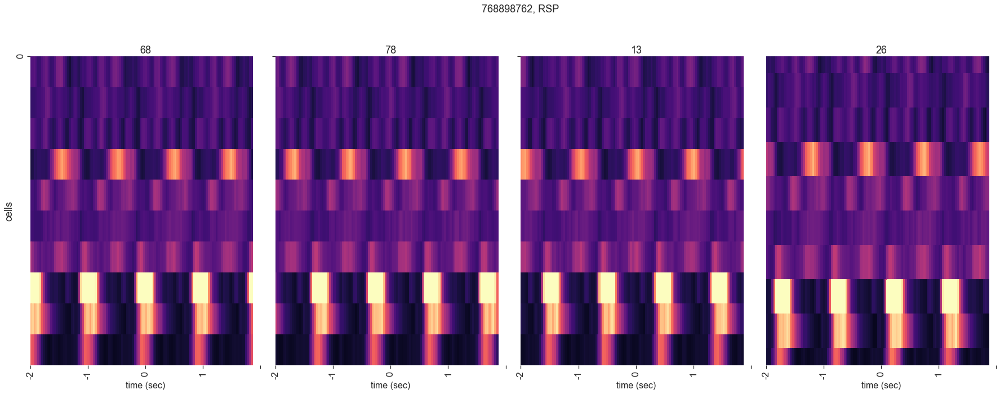

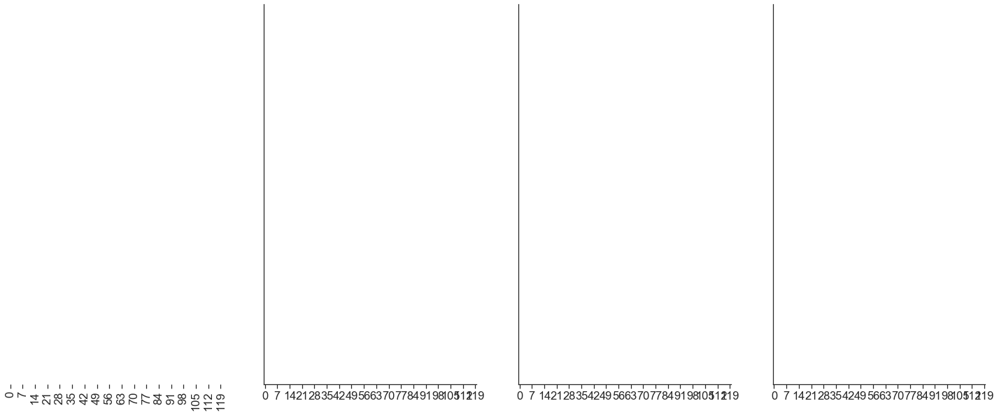

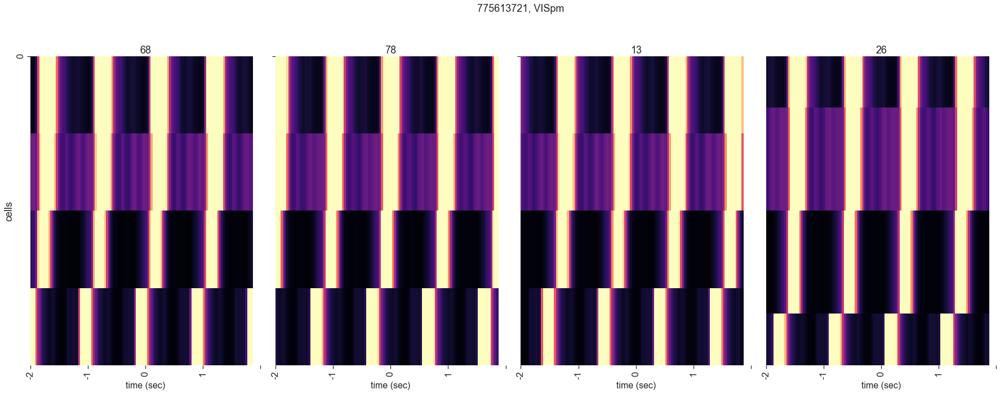

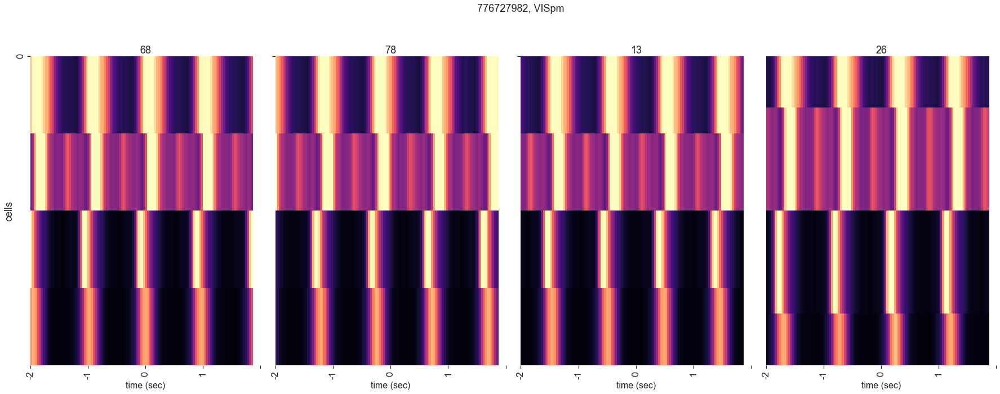

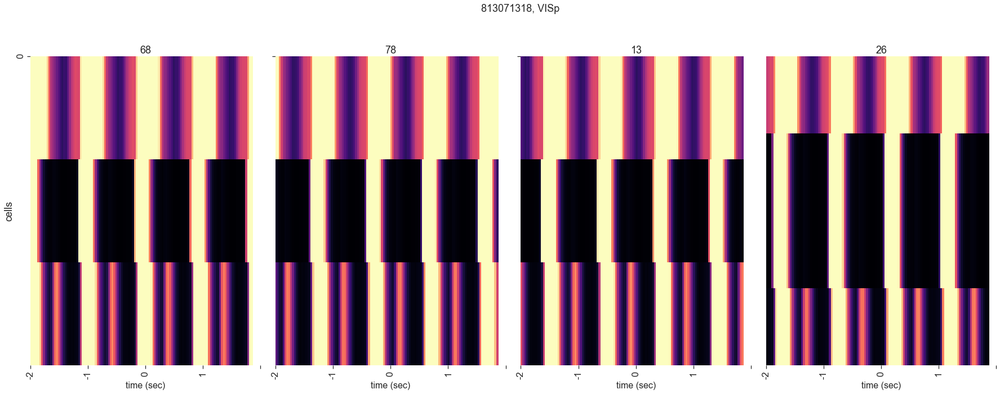

...

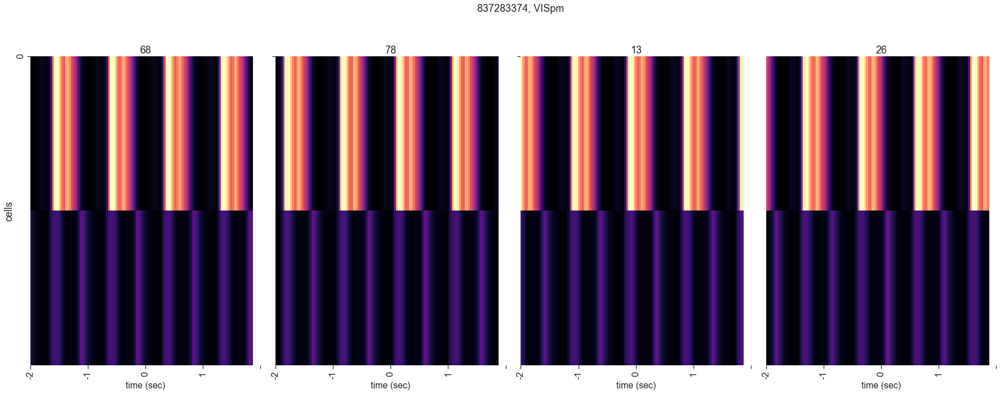

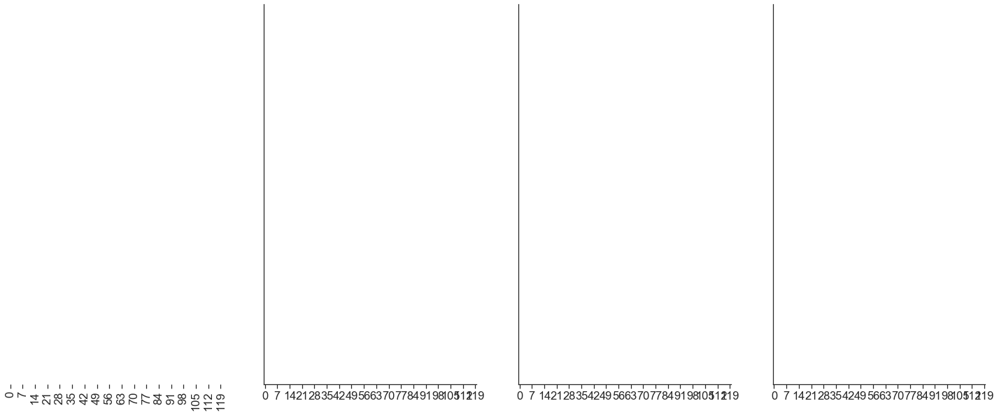

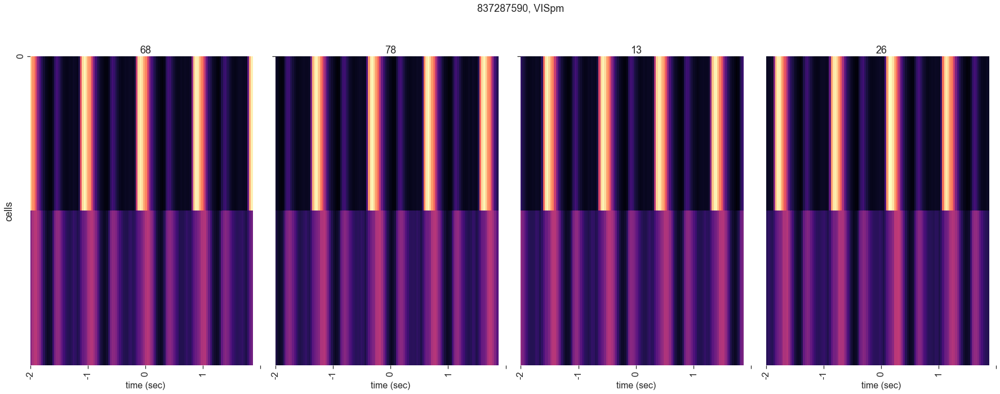

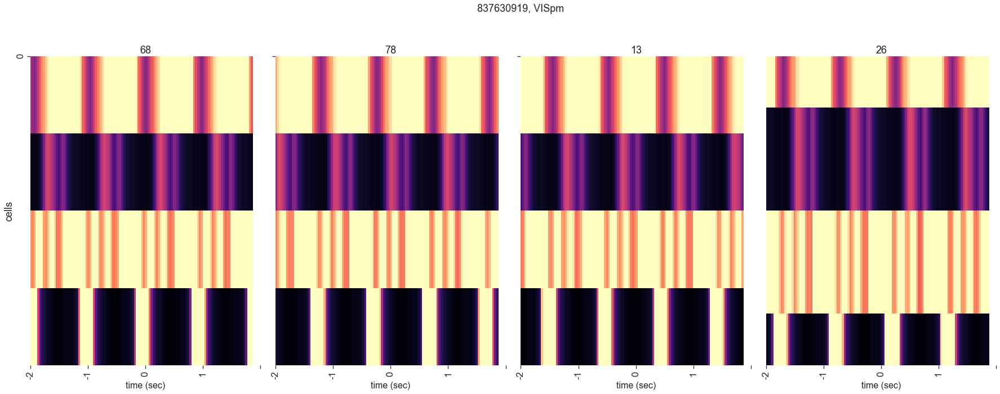

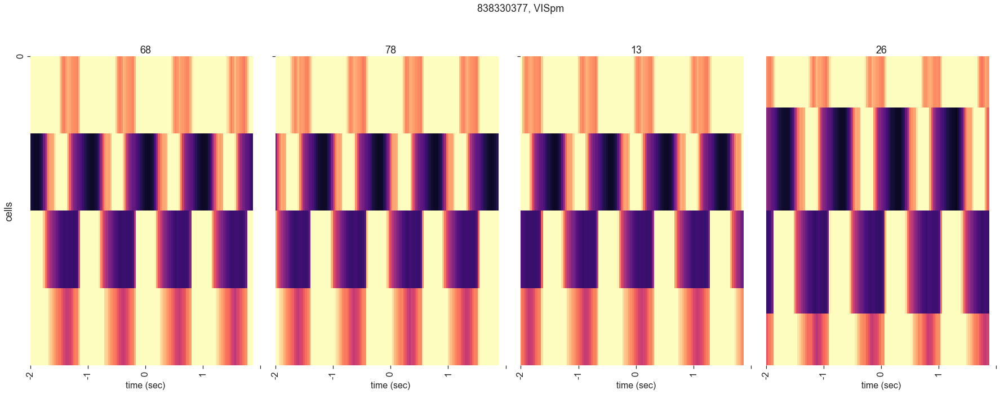

In [321]:
image_ids = sequence_images

for experiment_id in odf.experiment_id.unique():
    try:
        plot_mean_image_responses(odf[odf.experiment_id==experiment_id], image_ids, vmax=0.008, colorbar=False, ax=None, save_dir=None, folder=None, use_events=True,
                               interval_sec=1, window=[-2,2])
    except: 
        print(experiment_id)

Text(0.5, 0.98, 'superficial')

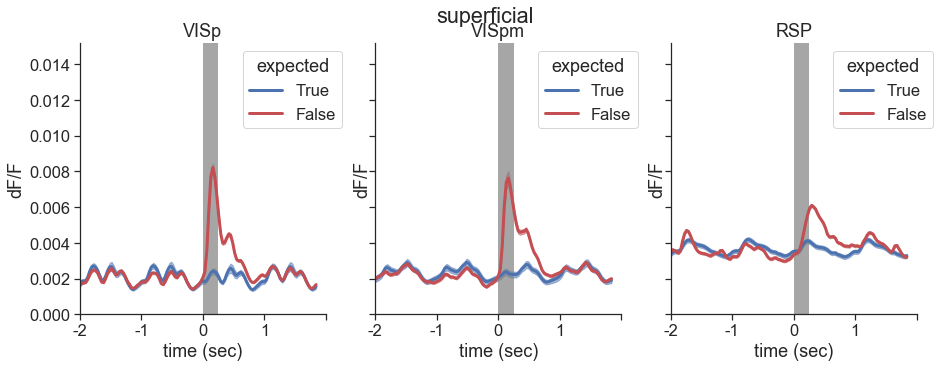

In [133]:
c = sns.color_palette()
colors = [c[0], c[3]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.depth=='superficial')].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='expected', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('superficial')

Text(0.5, 0.98, 'deep')

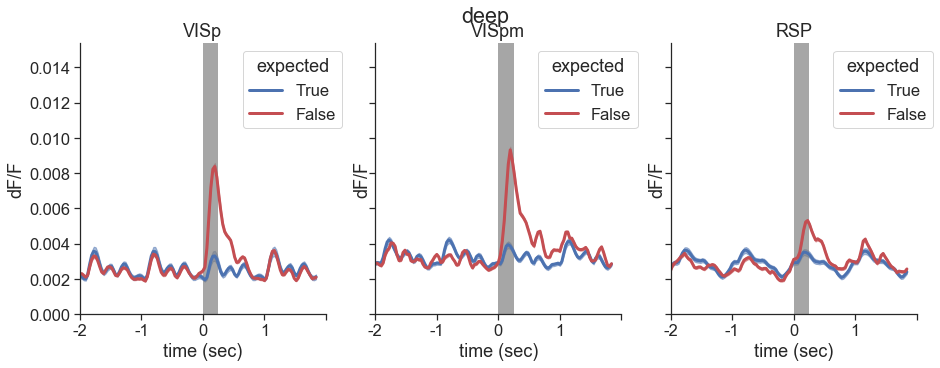

In [134]:
c = sns.color_palette()
colors = [c[0], c[3]]
figsize = (15,5)
fig, ax = plt.subplots(1,3, figsize=figsize, sharey=True)
for i,area in enumerate(areas):
    df = odf[(odf.area==area)&(odf.depth=='deep')].copy()
    ax[i] = plot_response_across_conditions_population(df, condition='expected', conditions=[True, False],
                                                   window=[-2, 2], ax=ax[i], colors=colors, title=area)
plt.suptitle('deep')

In [132]:
odf

,cell_specimen_id,image_id,oddball,mean_response,sem_response,mean_trace,sem_trace,pref_stim,fraction_significant_trials,fraction_responsive_trials,...,session_type,donor_id,experiment_date,specimen_id,depth,location,session_num,area,retrogradely_labeled,expected
0,768915941,6.0,True,0.000015,0.000014,"[8.50968698148599e-11, 3.720238322480506e-12, ...","[7.872724620843885e-11, 3.460640432655818e-12,...",False,0.000000,0.000000,...,behavior_session_1,416366,2018-10-25,753787399,superficial,RSP_superficial,1,RSP,False,False
1,768915941,13.0,False,0.001431,0.000120,"[0.0008259387979521318, 0.0008112338215326325,...","[0.00015156177494914525, 0.0001541630660198347...",False,0.020500,0.000000,...,behavior_session_1,416366,2018-10-25,753787399,superficial,RSP_superficial,1,RSP,False,NaN
2,768915941,17.0,True,0.000980,0.000924,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",False,0.000000,0.000000,...,behavior_session_1,416366,2018-10-25,753787399,superficial,RSP_superficial,1,RSP,False,False
3,768915941,22.0,True,0.006094,0.004962,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",False,0.100000,0.000000,...,behavior_session_1,416366,2018-10-25,753787399,superficial,RSP_superficial,1,RSP,False,False
4,768915941,26.0,False,0.002497,0.000217,"[0.0007811450115317037, 0.0005789902713344787,...","[0.00013984678227011888, 0.0001020979018990593...",False,0.038947,0.001053,...,behavior_session_1,416366,2018-10-25,753787399,superficial,RSP_superficial,1,RSP,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90589,848731002,89.0,True,0.001622,0.001539,"[2.4095915992731943e-06, 2.8778467701174954e-0...","[2.285939305353306e-06, 2.7301651651590845e-07...",False,0.100000,0.000000,...,behavior_session_2,437813,2019-04-09,827598535,deep,VISp_deep,2,VISp,False,False
90590,848731002,103.0,True,0.003441,0.002200,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.002...",False,0.100000,0.000000,...,behavior_session_2,437813,2019-04-09,827598535,deep,VISp_deep,2,VISp,False,False
90591,848731002,110.0,True,0.005878,0.002769,"[3.6930439211679226e-06, 4.4107113425942047e-0...","[3.5035284998391786e-06, 4.1843680267736185e-0...",False,0.100000,0.000000,...,behavior_session_2,437813,2019-04-09,827598535,deep,VISp_deep,2,VISp,False,False
90592,848731002,111.0,True,0.003921,0.002501,"[2.6500953437269025e-12, 9.068127600884243e-14...","[2.514101190835148e-12, 8.602781199549755e-14,...",False,0.100000,0.000000,...,behavior_session_2,437813,2019-04-09,827598535,deep,VISp_deep,2,VISp,False,False


#### oddball response by session

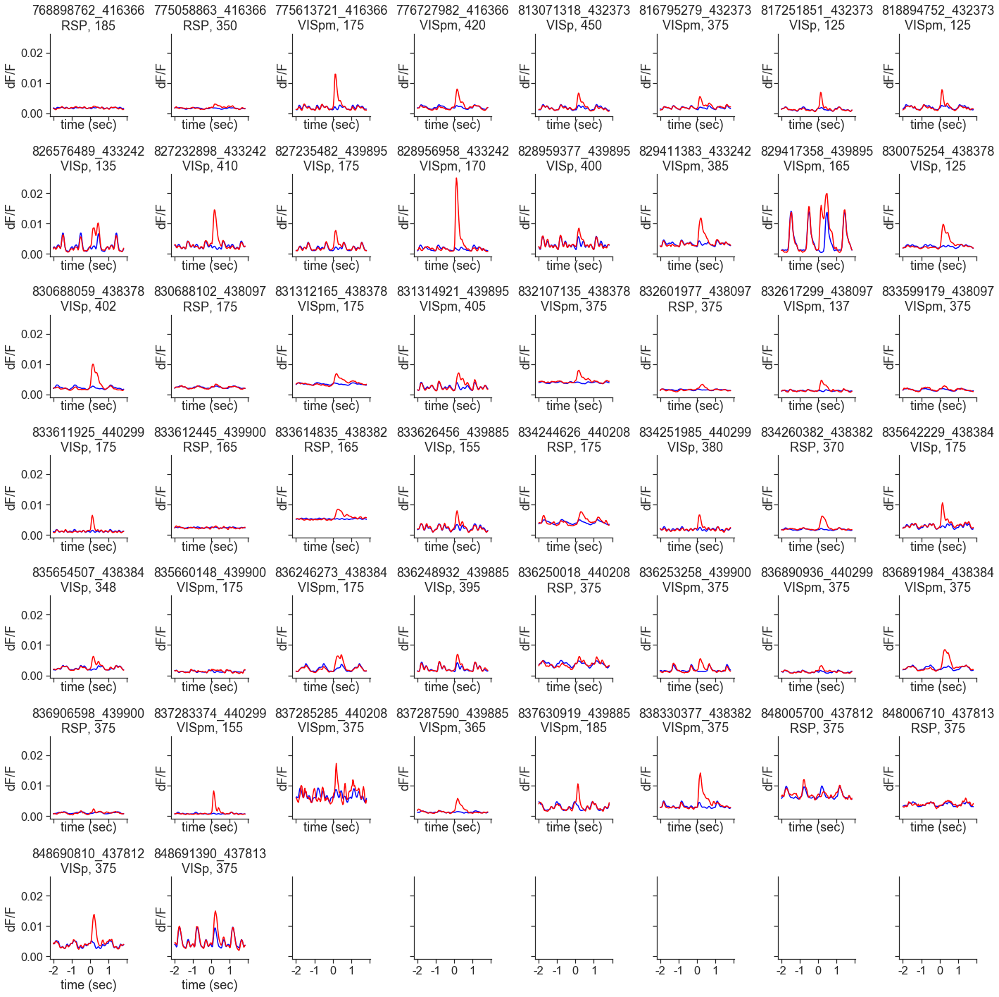

In [135]:
figsize=(20,20)
fig, ax = plt.subplots(7,8,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0

for experiment_id in odf.experiment_id.unique(): 
    edf = odf[odf.experiment_id==experiment_id]   
    sequence = edf[edf.image_id==images[3]].mean_trace.mean()
    oddballs = edf[edf.oddball==True].mean_trace.mean()

    ax[i].plot(sequence, color='blue', label='sequence')
    ax[i].plot(oddballs, color='red', label='oddballs')

    xticks, xticklabels = sf.get_xticks_xticklabels(sequence, 31., interval_sec=1)
    ax[i].set_xticks(xticks)
    ax[i].set_xticklabels([int(x) for x in xticklabels])
    ax[i].set_ylabel('dF/F')
    ax[i].set_xlabel('time (sec)')
    ax[i].set_title(str(experiment_id)+'_'+str(edf.donor_id.values[0])+'\n'+edf.targeted_structure.values[0]+', '+str(edf.imaging_depth.values[0]))
    i+=1
fig.tight_layout()

### oddball response metric - transitions control 

In [104]:
odf = odf.reset_index()

oddball_index = []
for index in odf.index.values: 
    row_df = odf.iloc[index]
    cell_specimen_id = row_df.cell_specimen_id
    image_id = row_df.image_id
    oddball_mean_response = row_df.mean_response
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)&(tdf.second_in_sequence==True)]
    transitions_mean_response = tcdf.mean_response.values[0]
    oddball_response_index = ((oddball_mean_response-transitions_mean_response)/(oddball_mean_response+transitions_mean_response))
    oddball_index.append(oddball_response_index)
odf['oddball_response_index'] = oddball_index

In [43]:
def plot_oddball_transition_responses(odf, tdf, cell_specimen_id, save_dir=None):
    images = oddball_images+sequence_images
    figsize=(20,2.5)
    fig, ax = plt.subplots(1, len(images), figsize=figsize, sharey=True)
    for i,image_id in enumerate(images): 
        cell_odf = odf[(odf.cell_specimen_id==cell_specimen_id)&(odf.image_id==image_id)]
        cell_tdf = tdf[(tdf.cell_specimen_id==cell_specimen_id)&(tdf.image_id==image_id)]
        ax[i].plot(cell_odf.mean_trace.values[0], color=sns.color_palette()[3], label='oddball_block')
        ax[i].plot(cell_tdf.mean_trace.values[0], color=sns.color_palette()[0], label='transition_control')
        xticks, xticklabels = sf.get_xticks_xticklabels(cell_odf.mean_trace.values[0], 31.)
        ax[i].set_xticks(xticks)
        ax[i].set_xticklabels(xticklabels)
        ax[i].set_xlabel('time (s)')
        ax[i].set_title(str(np.round(cell_odf.oddball_response_index.values[0], 2))+', '+str(np.round(cell_odf.fraction_significant_trials.values[0], 2)),fontsize=12)
    ax[0].set_ylabel('dF/F')
    ax[i].legend(fontsize='small')
    fig.tight_layout()
    fig.subplots_adjust(bottom=0.25)
    if save_dir: 
        sf.save_figure(fig, figsize, save_dir, 'oddball_transition_responses', str(int(cell_specimen_id)))
        plt.close()

C:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\ipykernel_launcher.py:17: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


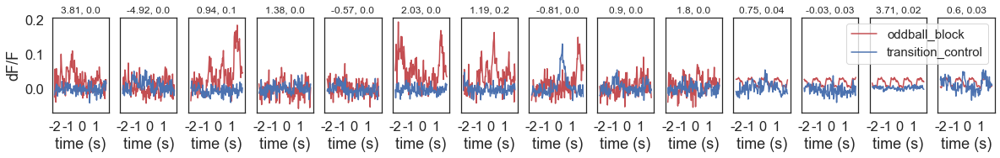

In [44]:
cell_specimen_id = odf.cell_specimen_id.unique()[0]

plot_oddball_transition_responses(odf, tdf, cell_specimen_id, save_dir=None)

In [45]:
# for cell_specimen_id in odf.cell_specimen_id.unique():
#     plot_oddball_transition_responses(odf, tdf, cell_specimen_id, save_dir=save_dir)

[None, None]

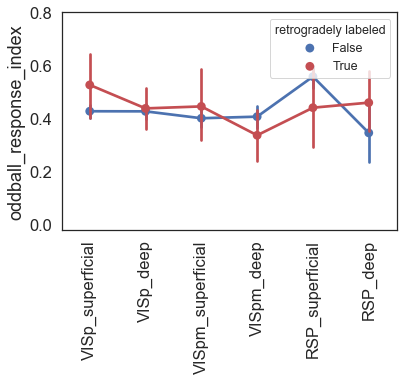

In [151]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf.copy()
df = df[df.oddball==True]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.1]
colors = [sns.color_palette()[0], sns.color_palette()[3]]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='oddball_response_index', order=locations, 
                   hue='retrogradely_labeled', palette=colors, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.set_ylim(-0.02, 0.8)
legend = ax.legend(fontsize='x-small', title='retrogradely labeled', loc='upper right')
plt.setp(legend.get_title(),fontsize='x-small')

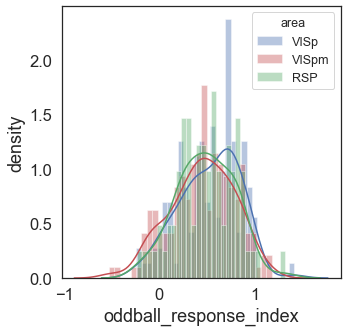

In [155]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'oddball_response_index'

df = odf.copy()
df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<5)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.01]
colors = [sns.color_palette()[0], sns.color_palette()[3], sns.color_palette()[2]]

fig, ax = plt.subplots(1, figsize=(5,5), sharey=True, sharex=True)
for i, area in enumerate(['VISp', 'VISpm', 'RSP']):
    ax = sns.distplot(df[(df.area==area)&(df.retrogradely_labeled==label)][metric].values, bins=30,
                  color=colors[i], ax=ax, label=area)
    ax.set_xlabel(metric)
    legend = ax.legend(fontsize='x-small', title='area', loc='upper right')
    plt.setp(legend.get_title(),fontsize='x-small')
    ax.set_ylabel('density')
#     ax.set_title(area)


Text(0, 0.5, 'density')

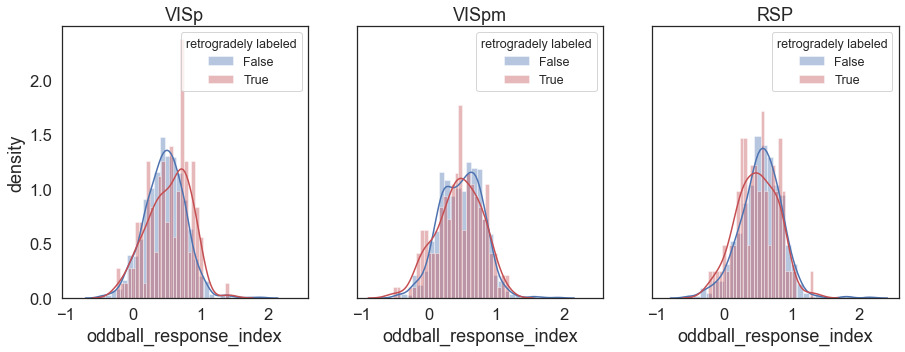

In [159]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'oddball_response_index'

df = odf.copy()
df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<5)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.01]
colors = [sns.color_palette()[0], sns.color_palette()[3]]

fig, ax = plt.subplots(1,3, figsize=(15,5), sharey=True, sharex=True)
for i, area in enumerate(['VISp', 'VISpm', 'RSP']):
    for c, label in enumerate(df.retrogradely_labeled.unique()):
        ax[i] = sns.distplot(df[(df.area==area)&(df.retrogradely_labeled==label)][metric].values, bins=30,
                      color=colors[c], ax=ax[i], label=label)
        ax[i].set_xlabel(metric)
        legend = ax[i].legend(fontsize='x-small', title='retrogradely labeled', loc='upper right')
        plt.setp(legend.get_title(),fontsize='x-small')
        ax[i].set_title(area)
ax[0].set_ylabel('density')


Text(0, 0.5, 'density')

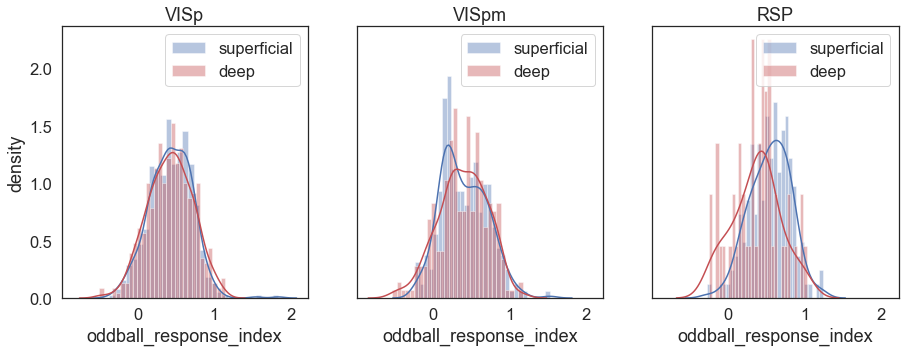

In [158]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'oddball_response_index'

df = odf.copy()
df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<5)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.1]

fig, ax = plt.subplots(1,3, figsize=(15,5), sharey=True, sharex=True)
for i, area in enumerate(['VISp', 'VISpm', 'RSP']):
    for c, depth in enumerate(df.depth.unique()):
        ax[i] = sns.distplot(df[(df.area==area)&(df.depth==depth)][metric].values, bins=30,
                      color=colors[c], ax=ax[i], label=depth)
        ax[i].set_xlabel(metric)
        ax[i].legend()
        ax[i].set_title(area)
ax[0].set_ylabel('density')


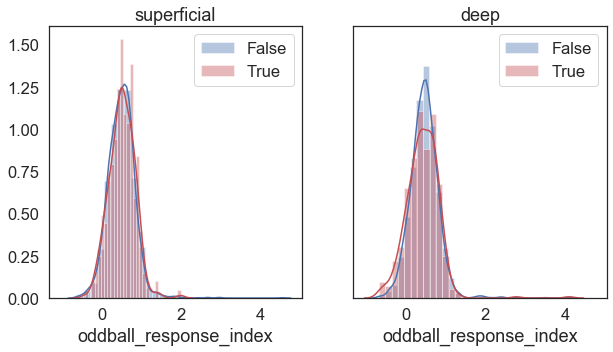

In [49]:
metric = 'oddball_response_index'

df = odf.copy()
df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<5)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots(1,2, figsize=(10,5), sharey=True, sharex=True)
for i, depth in enumerate(df.depth.unique()):
    for c, label in enumerate(df.retrogradely_labeled.unique()):
        ax[i] = sns.distplot(df[(df.depth==depth)&(df.retrogradely_labeled==label)][metric].values, bins=30,
                      color=colors[c], ax=ax[i], label=label)
        ax[i].set_xlabel(metric)
        ax[i].legend()
        ax[i].set_title(depth)


TypeError: distplot() got an unexpected keyword argument 'data'

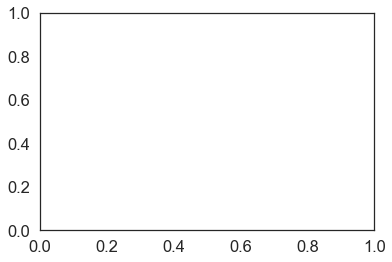

In [50]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf.copy()
df = df[df.oddball==True]
# df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.distplot(data=df, x='location', y='oddball_response_index', order=locations, hue='retrogradely_labeled', ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')

### oddball response metric -  randomized control

In [ ]:
odf = odf.reset_index()

oddball_index = []
for index in odf.index.values: 
    row_df = odf.iloc[index]
    cell_specimen_id = row_df.cell_specimen_id
    image_id = row_df.image_id
    oddball_mean_response = row_df.mean_response
    pre_cdf = pre_df[(pre_df.image_id==image_id)&(pre_df.cell_specimen_id==cell_specimen_id)]
    control_mean_response = pre_cdf.mean_response.values[0]
    oddball_response_index = ((oddball_mean_response-control_mean_response)/(oddball_mean_response+control_mean_response))
    oddball_index.append(oddball_response_index)
odf['oddball_response_index_control'] = oddball_index

### occlusion metric 

Text(0.5, 1.0, 'occlusion population response')

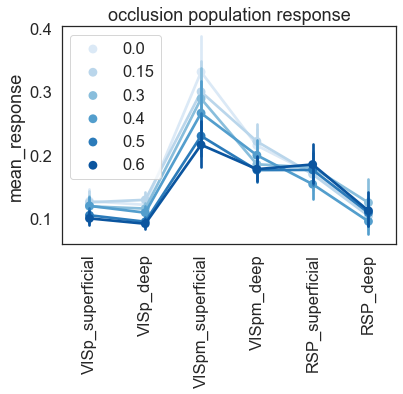

In [174]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = ocdf.copy()
# df = df[df.oddball==True]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.1]
cells = df[df.fraction_significant_trials>0.1].cell_specimen_id.unique()
df = df[df.cell_specimen_id.isin(cells)]
colors = [sns.color_palette()[0], sns.color_palette()[3]]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='mean_response', order=locations, hue='fraction_occlusion', 
                   palette=sns.color_palette('Blues'), ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.legend()
# ax.set_ylim(0,0.8)
ax.set_title('occlusion population response')

[None, None]

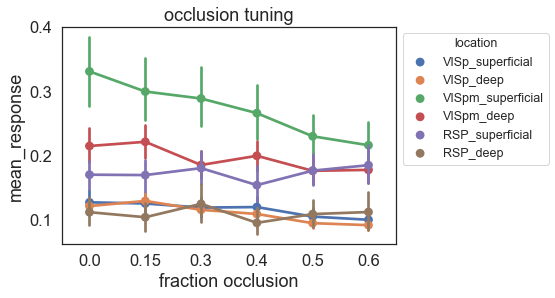

In [173]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = ocdf.copy()
# df = df[df.oddball==True]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
cells = df[df.fraction_significant_trials>0.1].cell_specimen_id.unique()
df = df[df.cell_specimen_id.isin(cells)]
colors = [sns.color_palette()[0], sns.color_palette()[3]]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='fraction_occlusion', y='mean_response', order=np.sort(df.fraction_occlusion.unique()),
                   hue='location', hue_order=locations, palette=sns.color_palette(), ax=ax)
ax.set_xticklabels(np.sort(df.fraction_occlusion.unique()))
ax.set_xlabel('fraction occlusion')
# ax.set_ylim(0,0.8)
ax.set_title('occlusion tuning')
legend = ax.legend(fontsize='x-small', title='location', bbox_to_anchor=(1,1))
plt.setp(legend.get_title(),fontsize='x-small')

Text(0.5, 1.0, 'occlusion population response')

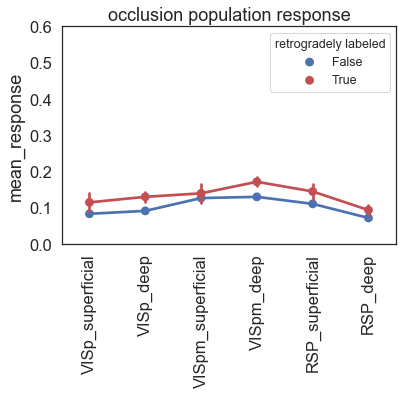

In [166]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = ocdf.copy()
# df = df[df.oddball==True]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.1]
colors = [sns.color_palette()[0], sns.color_palette()[3]]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='mean_response', order=locations, hue='retrogradely_labeled', 
                   palette=colors, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.set_ylim(0,0.6)
legend = ax.legend(fontsize='x-small', title='retrogradely labeled', loc='upper right')
plt.setp(legend.get_title(),fontsize='x-small')
ax.set_title('occlusion population response')

### need to calculate the pref amount of occlusion

In [ ]:
# locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

# df = ocdf.copy()
# # df = df[df.oddball==True]
# # df = df[df.pref_stim==True]
# # df = df[df.mean_response>0.05]
# colors = sns.color_palette('Blues')

# fig, ax = plt.subplots()
# for i, location in enumerate(locations): 
#     tmp = df[df.location==location]
#     for r, occ in enumerate(tmp.fraction_occlusion.unique()):
#         fraction_pref = len(tmp[(tmp.pref_stim==True)&(tmp.fraction_occlusion==occ)])/float(len(tmp.cell_specimen_id.unique()))
#         ax.plot(i, fraction_pref, 'o', color=colors[r])
# for r, occ in enumerate(tmp.fraction_occlusion.unique()):
#     fraction_pref = len(tmp[(tmp.pref_stim==True)&(tmp.fraction_occlusion==occ)])/float(len(tmp.cell_specimen_id.unique()))
#     ax.plot(i, fraction_pref, 'o', color=colors[r], label=occ)
# ax.set_xticks(range(len(locations)))
# ax.set_xticklabels(locations, rotation=90)
# ax.set_xlabel('')
# ax.set_ylim(-0.05,1.05)
# legend = ax.legend(fontsize='x-small', title='fraction occlusion', loc='upper right')
# plt.setp(legend.get_title(),fontsize='x-small')
# ax.set_ylabel('fraction responsive cells')
# ax.set_title('occlusion responsiveness');

In [213]:
def occlusion_response_index_byimage(dfc, val='mean_response'):
    dfc_occlusion = dfc[dfc['fraction_occlusion']!=0]
    dfc_noocclusion = dfc[dfc['fraction_occlusion']==0]
    occlusion_zscore = abs(dfc_occlusion.groupby('image_id')[val].mean()-dfc_noocclusion.groupby('image_id')[val].mean())/dfc_occlusion.groupby('image_id')[val].std()
    return occlusion_zscore 

def occlusion_response_index_bycell(dfc, val='mean_response'):
#     dfc = dfc[dfc.pref_stim==True]
    dfc_occlusion = dfc[dfc['fraction_occlusion']!=0]
    dfc_noocclusion = dfc[dfc['fraction_occlusion']==0]
    occlusion_zscore = abs(dfc_occlusion.groupby(['cell_specimen_id', 'image_id'])[val].mean()-dfc_noocclusion.groupby(['cell_specimen_id', 'image_id'])[val].mean())/dfc_occlusion.groupby(['cell_specimen_id', 'image_id'])[val].std()
    return occlusion_zscore 

In [214]:
occlusion_values = occlusion_response_index_bycell(ocdf, val='mean_response')

In [215]:
oc = pd.DataFrame(occlusion_values)
oc = oc.rename(columns={'mean_response':'occlusion_index_zscore'})

In [220]:
metric_df = pd.merge(odf, oc, left_on=['cell_specimen_id', 'image_id'], right_on=['cell_specimen_id', 'image_id'])

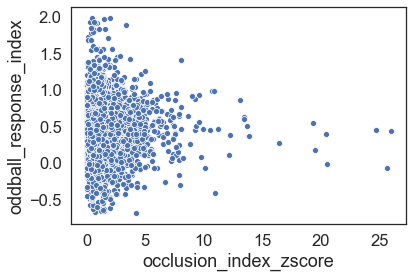

In [222]:
df = metric_df.copy()
df = df[df.pref_stim==True]
df = df[(df.oddball_response_index<2)&(df.occlusion_index_zscore<40)]
sns.scatterplot(data=df, x='occlusion_index_zscore', y='oddball_response_index')

In [236]:
ocdf_metric = pd.merge(ocdf, oc, left_on=['cell_specimen_id', 'image_id'], right_on=['cell_specimen_id', 'image_id'])

In [237]:
ocdf_metric

,cell_specimen_id,image_id,fraction_occlusion,mean_response,sem_response,mean_trace,sem_trace,pref_stim,fraction_significant_trials,fraction_responsive_trials,...,session_type,donor_id,experiment_date,specimen_id,session_num,area,depth,location,retrogradely_labeled,occlusion_index_zscore
0,768915941,6.0,0.00,0.007132,0.005762,"[0.008543769735872309, 0.007813074390248786, -...","[0.01655297214546789, 0.018861630796218776, 0....",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.388872
1,768915941,6.0,0.15,0.002753,0.006746,"[0.0234037331941625, -0.008217008895151413, -0...","[0.011251730909133575, 0.024109834726767764, 0...",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.388872
2,768915941,6.0,0.30,-0.005194,0.009858,"[0.0327278887627024, 0.030279690087803908, -0....","[0.020844536612701477, 0.014577636441001546, 0...",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.388872
3,768915941,6.0,0.40,0.008397,0.007399,"[-0.03827911345891171, 0.011186089977715186, -...","[0.019281829090979294, 0.018007816915256207, 0...",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.388872
4,768915941,6.0,0.50,0.008519,0.008346,"[-0.009726153905977203, 0.01902948127544127, 0...","[0.019741392317524198, 0.02088624239877071, 0....",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.388872
5,768915941,6.0,0.60,0.009253,0.011665,"[-0.025178352688432104, 0.017183918380335665, ...","[0.02817197410286694, 0.02438122885652009, 0.0...",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.388872
6,768915941,17.0,0.00,0.015128,0.008645,"[0.019701833758226425, 0.023710864575264085, 0...","[0.026784984535598043, 0.037943529096369145, 0...",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.382596
7,768915941,17.0,0.15,0.020182,0.006439,"[0.005305779069759863, -0.04011808455654804, -...","[0.016056774319860558, 0.0142993954627923, 0.0...",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.382596
8,768915941,17.0,0.30,0.025068,0.017557,"[0.023288719736160028, 0.0010679292026893998, ...","[0.024804632709051175, 0.02591368583630147, 0....",False,0.1,0.1,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.382596
9,768915941,17.0,0.40,0.004080,0.003932,"[0.04928234550400494, -0.0008330831300793866, ...","[0.018936587792229866, 0.01329548319540091, 0....",False,0.0,0.0,...,behavior_session_1,416366,2018-10-25,753787399,1,RSP,superficial,RSP_superficial,False,0.382596


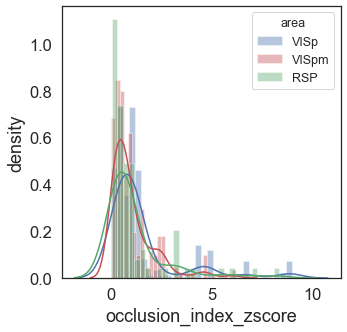

In [240]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'occlusion_index_zscore'

df = ocdf_metric.copy()
# df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<10)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.1]
colors = [sns.color_palette()[0], sns.color_palette()[3], sns.color_palette()[2]]

fig, ax = plt.subplots(1, figsize=(5,5), sharey=True, sharex=True)
for i, area in enumerate(['VISp', 'VISpm', 'RSP']):
    ax = sns.distplot(df[(df.area==area)&(df.retrogradely_labeled==label)][metric].values, bins=30,
                  color=colors[i], ax=ax, label=area)
    ax.set_xlabel(metric)
    legend = ax.legend(fontsize='x-small', title='area', loc='upper right')
    plt.setp(legend.get_title(),fontsize='x-small')
    ax.set_ylabel('density')
#     ax.set_title(area)


Text(0, 0.5, 'density')

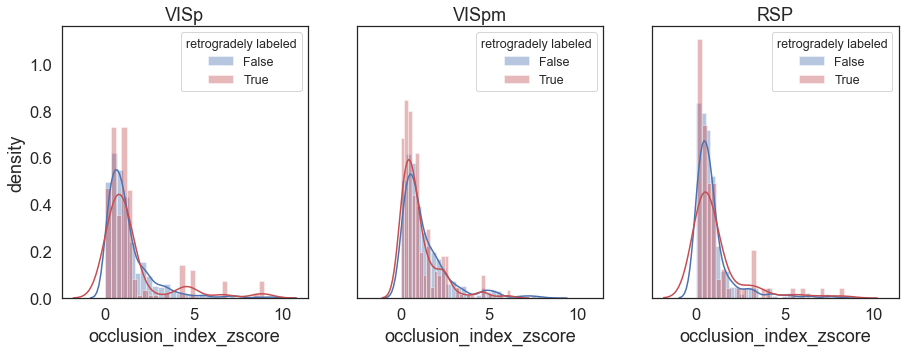

In [241]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'occlusion_index_zscore'

df = ocdf_metric.copy()
# df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<10)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.1]
colors = [sns.color_palette()[0], sns.color_palette()[3]]

fig, ax = plt.subplots(1,3, figsize=(15,5), sharey=True, sharex=True)
for i, area in enumerate(['VISp', 'VISpm', 'RSP']):
    for c, label in enumerate(df.retrogradely_labeled.unique()):
        ax[i] = sns.distplot(df[(df.area==area)&(df.retrogradely_labeled==label)][metric].values, bins=30,
                      color=colors[c], ax=ax[i], label=label)
        ax[i].set_xlabel(metric)
        legend = ax[i].legend(fontsize='x-small', title='retrogradely labeled', loc='upper right')
        plt.setp(legend.get_title(),fontsize='x-small')
        ax[i].set_title(area)
ax[0].set_ylabel('density')


Text(0, 0.5, 'density')

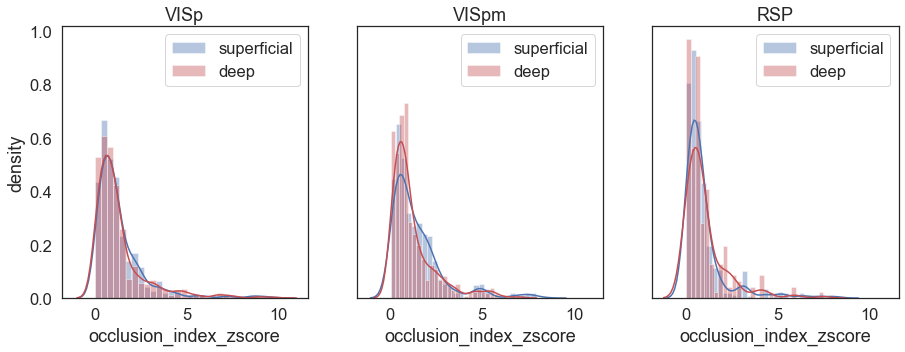

In [242]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'oddball_response_index'

metric = 'occlusion_index_zscore'

df = ocdf_metric.copy()
# df = df[df.oddball==True]
df = df[(df[metric]>-5)&(df[metric]<10)]
df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
df = df[df.fraction_significant_trials>0.1]

fig, ax = plt.subplots(1,3, figsize=(15,5), sharey=True, sharex=True)
for i, area in enumerate(['VISp', 'VISpm', 'RSP']):
    for c, depth in enumerate(df.depth.unique()):
        ax[i] = sns.distplot(df[(df.area==area)&(df.depth==depth)][metric].values, bins=30,
                      color=colors[c], ax=ax[i], label=depth)
        ax[i].set_xlabel(metric)
        ax[i].legend()
        ax[i].set_title(area)
ax[0].set_ylabel('density')


In [231]:
def plot_occlusion_responses(ocdf, metric_df, cell_specimen_id, save_dir=None):
    images = oddball_images
    colors = sns.color_palette('Blues')
    figsize=(20,2.5)
    fig, ax = plt.subplots(1, len(images), figsize=figsize, sharey=True)
    for i,image_id in enumerate(images): 
        cell_ocdf = ocdf[(ocdf.cell_specimen_id==cell_specimen_id)&(ocdf.image_id==image_id)]
        for o, fraction_occlusion in enumerate(np.sort(ocdf.fraction_occlusion.unique())):
            occ_df = cell_ocdf[cell_ocdf.fraction_occlusion==fraction_occlusion]
            ax[i].plot(occ_df.mean_trace.values[0], color=colors[o], label=fraction_occlusion)
        xticks, xticklabels = sf.get_xticks_xticklabels(cell_ocdf.mean_trace.values[0], 31.)
        ax[i].set_xticks(xticks)
        ax[i].set_xticklabels(xticklabels)
        ax[i].set_xlabel('time (s)')
        metric_value = metric_df[(metric_df.cell_specimen_id==cell_specimen_id)&(metric_df.image_id==image_id)].occlusion_index_zscore.values[0]
        ax[i].set_title(str(np.round(metric_value,2))+', '+str(np.round(cell_ocdf.fraction_significant_trials.values[0], 2)),fontsize=14)
                                        
    ax[0].set_ylabel('dF/F')
    legend = ax[i].legend(fontsize='x-small', title='fraction occlusion', bbox_to_anchor=(1,1))
    plt.setp(legend.get_title(),fontsize='x-small')
    fig.tight_layout()
    fig.subplots_adjust(bottom=0.25)
    fig.subplots_adjust(right=0.8)
    if save_dir: 
        sf.save_figure(fig, figsize, save_dir, 'occlusion_responses', str(int(cell_specimen_id)))
        plt.close()

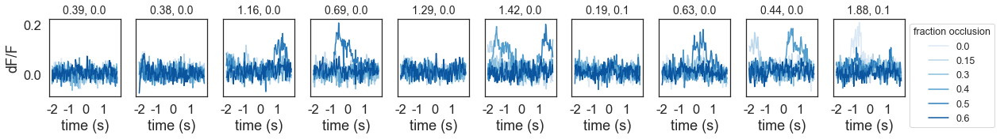

In [232]:
plot_occlusion_responses(ocdf, metric_df, cell_specimen_id, save_dir=None)

KeyboardInterrupt: 

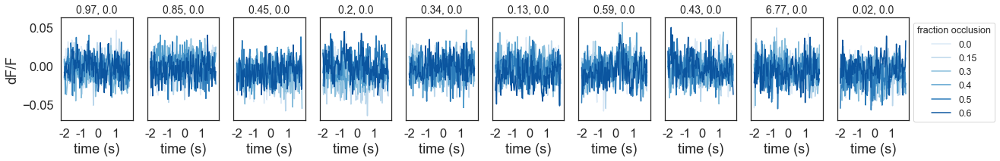

In [235]:
for cell_specimen_id in ocdf.cell_specimen_id.unique():
    plot_occlusion_responses(ocdf, metric_df, cell_specimen_id, save_dir=save_dir)

In [116]:
odf = odf.reset_index()

occlusion_index = []
for index in odf.index.values: 
    row_df = odf.iloc[index]
    cell_specimen_id = row_df.cell_specimen_id
    image_id = row_df.image_id
    occlusion_mean_response = row_df.mean_response
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)&(tdf.second_in_sequence==True)]
    transitions_mean_response = tcdf.mean_response.values[0]
    occlusion_response_index = ((oddball_mean_response-transitions_mean_response)/(oddball_mean_response+transitions_mean_response))
    occlusion_index.append(occlusion_response_index)
odf['occlusion_response_index'] = occlusion_index

Index(['index', 'cell_specimen_id', 'image_id', 'oddball', 'mean_response_x',
       'sem_response', 'mean_trace', 'sem_trace', 'pref_stim',
       'fraction_significant_trials', 'fraction_responsive_trials',
       'experiment_id', 'experiment_container_id', 'targeted_structure',
       'imaging_depth', 'cre_line', 'reporter_line', 'full_genotype',
       'session_type', 'donor_id', 'experiment_date', 'specimen_id',
       'session_num', 'area', 'depth', 'location', 'retrogradely_labeled',
       'oddball_response_index', 'mean_response_y'],
      dtype='object')

In [ ]:
ocdf = ocdf.reset_index()

oddball_index = []
for index in ocdf.index.values: 
    row_df = ocdf.iloc[index]
    cell_specimen_id = row_df.cell_specimen_id
    image_id = row_df.image_id
    oddball_mean_response = row_df.mean_response
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)&(tdf.second_in_sequence==True)]
    transitions_mean_response = tcdf.mean_response.values[0]
    oddball_response_index = ((oddball_mean_response-transitions_mean_response)/(oddball_mean_response+transitions_mean_response))
    oddball_index.append(oddball_response_index)
odf['occlusion_response_index'] = oddball_index

In [ ]:
df = ocdf.copy()

df_shallowVISp = df[(df['targeted_structure']=='VISp')&(df['imaging_depth']<=300)]

df_focus = df_shallowVISp
del df_shallowVISp

responsive_cells = df_focus.cell_specimen_id.unique()

for ii in range(0,len(responsive_cells)):
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]])<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if not 0 in list(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion']):
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion'].unique())<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]

ori_bycell=occlusion_response_index_bycell(df_focus)
ori_shallowVISp=ori_bycell.dropna()


# In[]: 
df_deepVISp = df[(df['targeted_structure']=='VISp')&(df['imaging_depth']>300)]

df_focus = df_deepVISp
del df_deepVISp

responsive_cells = df_focus.cell_specimen_id.unique()

for ii in range(0,len(responsive_cells)):
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]])<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if not 0 in list(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion']):
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion'].unique())<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]

ori_bycell=occlusion_response_index_bycell(df_focus)
ori_deepVISp=ori_bycell.dropna()


# In[]:      

df_shallowVISpm = df[(df['targeted_structure']=='VISpm')&(df['imaging_depth']<=300)]

df_focus = df_shallowVISpm
del df_shallowVISpm

responsive_cells = df_focus.cell_specimen_id.unique()

for ii in range(0,len(responsive_cells)):
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]])<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if not 0 in list(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion']):
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion'].unique())<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]

ori_bycell=occlusion_response_index_bycell(df_focus)
ori_shallowVISpm=ori_bycell.dropna()


# In[]: 
df_deepVISpm = df[(df['targeted_structure']=='VISpm')&(df['imaging_depth']>300)]

df_focus = df_deepVISpm
del df_deepVISpm

responsive_cells = df_focus.cell_specimen_id.unique()

for ii in range(0,len(responsive_cells)):
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]])<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if not 0 in list(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion']):
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion'].unique())<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]

ori_bycell=occlusion_response_index_bycell(df_focus)
ori_deepVISpm=ori_bycell.dropna()


# In[]:      
#cache_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\opc\opc_analysis'
#cache_dir = r"C:\Users\hannahc\Desktop\opc_data"

df_shallowRSP = df[(df['targeted_structure']=='RSP')&(df['imaging_depth']<=300)]

df_focus = df_shallowRSP
del df_shallowRSP

responsive_cells = df_focus.cell_specimen_id.unique()

for ii in range(0,len(responsive_cells)):
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]])<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if not 0 in list(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion']):
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion'].unique())<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]

ori_bycell=occlusion_response_index_bycell(df_focus)
ori_shallowRSP=ori_bycell.dropna()


# In[]: 
df_deepRSP = df[(df['targeted_structure']=='VISp')&(df['imaging_depth']>300)]

df_focus = df_deepRSP
del df_deepRSP

responsive_cells = df_focus.cell_specimen_id.unique()

for ii in range(0,len(responsive_cells)):
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]])<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if not 0 in list(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion']):
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]
    if len(df_focus[df_focus['cell_specimen_id']==responsive_cells[ii]]['fraction_occlusion'].unique())<3:
        df_focus = df_focus[df_focus['cell_specimen_id']!=responsive_cells[ii]]

ori_bycell=occlusion_response_index_bycell(df_focus)
ori_deepRSP=ori_bycell.dropna()


# In[]: 

areas = [['shallowVISp']*len(ori_shallowVISp)+ ['deepVISp']*len(ori_deepVISp)
+['shallowVISpm']*len(ori_shallowVISpm)+ ['deepVISpm']*len(ori_deepVISpm)+['shallowRSP']*len(ori_shallowRSP)+ ['deepRSP']*len(ori_deepRSP)]
areas =np.array(areas[0])
all_ori = ori_shallowVISp.append(ori_deepVISp)
all_ori= all_ori.append(ori_shallowVISpm)
all_ori= all_ori.append(ori_deepVISpm)
all_ori= all_ori.append(ori_shallowRSP)
all_ori= all_ori.append(ori_deepRSP)
df_ori = pd.DataFrame({'ORI':all_ori,'area':areas} )

# In[]: 
ori_thresh = 1
df_occlusion_pref = df_ori[df_ori.ORI>=1]
n_occlusion_pref = df_occlusion_pref.groupby('area').count()
df_occlusion_nonpref = df_ori[df_ori.ORI<1]
n_occlusion_nonpref = df_occlusion_nonpref.groupby('area').count()

n_occlusion_pref = n_occlusion_pref.rename(columns={'ORI': 'occlusion preferred'})
n_occlusion_nonpref = n_occlusion_nonpref.rename(columns={'ORI': 'occlusion not preferred'})
newdf =pd.concat([n_occlusion_pref,n_occlusion_nonpref], axis=1)

In [ ]:
# In[]:
arealist = list(newdf.index.unique())
fig,ax = plt.subplots(figsize=(9,4))
ax.boxplot([df_ori.ORI[df_ori.area==arealist[0]].values,df_ori.ORI[df_ori.area==arealist[1]].values,
            df_ori.ORI[df_ori.area==arealist[2]].values,df_ori.ORI[df_ori.area==arealist[3]].values,
            df_ori.ORI[df_ori.area==arealist[4]].values,df_ori.ORI[df_ori.area==arealist[5]].values])
ax.set_xticks(np.arange(1,7,1))
ax.set_xticklabels(tuple(arealist),fontsize = 12)
ax.set_ylim([0,50])
ax.set_ylabel('Occlusion Response Index',fontsize = 14)
plt.show()

# In[]: 

import seaborn as sns        
%matplotlib inline

#ax = sns.scatterplot(x="areas", y="ORI", hue="areas",data=df_ori)

fig,ax = plt.subplots()
arealist = list(newdf.index.unique())
colors = ["red"]
jj = 0
for i in arange(1,7,1):
    y = df_ori.ORI[df_ori.area==arealist[jj]]
    # Add some random "jitter" to the x-axis
    x = np.random.normal(i, 0.03, size=len(y))
    ax.scatter(x, y, c=colors[0], alpha=0.5)
    jj = jj+1

ax.boxplot([df_ori.ORI[df_ori.area==arealist[0]].values,df_ori.ORI[df_ori.area==arealist[1]].values,
            df_ori.ORI[df_ori.area==arealist[2]].values,df_ori.ORI[df_ori.area==arealist[3]].values,
            df_ori.ORI[df_ori.area==arealist[4]].values,df_ori.ORI[df_ori.area==arealist[5]].values])
ax.set_xticks(arealist)
ax.set_ylabel('Occlusion Response Index')
plt.show()

### pick a cell and plot stuff

In [89]:
save_dir = os.path.join(cache_dir, 'multi_session_summary_figures')

In [25]:
cell_specimen_id = cell_specimen_ids[10]

In [86]:
cell_specimen_id = responsive_cells[1]

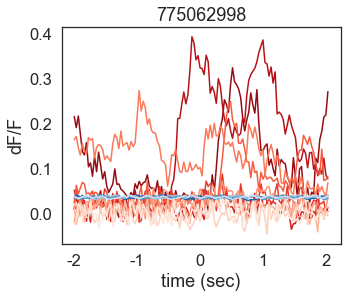

In [90]:
figsize = (5,4)
fig, ax = plt.subplots(figsize=figsize)
for image_id in images[::-1]: 
    cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
    mean_trace = cdf.mean_trace.values[0]
    if image_id in sequence_images: 
        ind = np.where(sequence_images==image_id)[0][0]
        color = sequence_colors[ind]
    else: 
        ind = np.where(oddball_images==image_id)[0][0]
        color = oddball_colors[ind]
    ax.plot(mean_trace, color=color)
    xticks, xticklabels = sf.get_xticks_xticklabels(mean_trace, 31., interval_sec=1)
    ax.set_xticks(xticks)
    ax.set_xticklabels([int(x) for x in xticklabels])
    ax.set_ylabel('dF/F')
    ax.set_xlabel('time (sec)')
    ax.set_title(cell_specimen_id)

In [93]:
for cell_specimen_id in cell_specimen_ids:
    figsize = (5,4)
    fig, ax = plt.subplots(figsize=figsize)
    for image_id in images[::-1]: 
        cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
        mean_trace = cdf.mean_trace.values[0]
        if image_id in sequence_images: 
            ind = np.where(sequence_images==image_id)[0][0]
            color = sequence_colors[ind]
        else: 
            ind = np.where(oddball_images==image_id)[0][0]
            color = oddball_colors[ind]
        ax.plot(mean_trace, color=color)
        xticks, xticklabels = sf.get_xticks_xticklabels(mean_trace, 31., interval_sec=1)
        ax.set_xticks(xticks)
        ax.set_xticklabels([int(x) for x in xticklabels])
        ax.set_ylabel('dF/F')
        ax.set_xlabel('time (sec)')
        ax.set_title(cell_specimen_id)
    sf.save_figure(fig, figsize, save_dir, 'oddball_mean_trace', str(cell_specimen_id))
    plt.close()

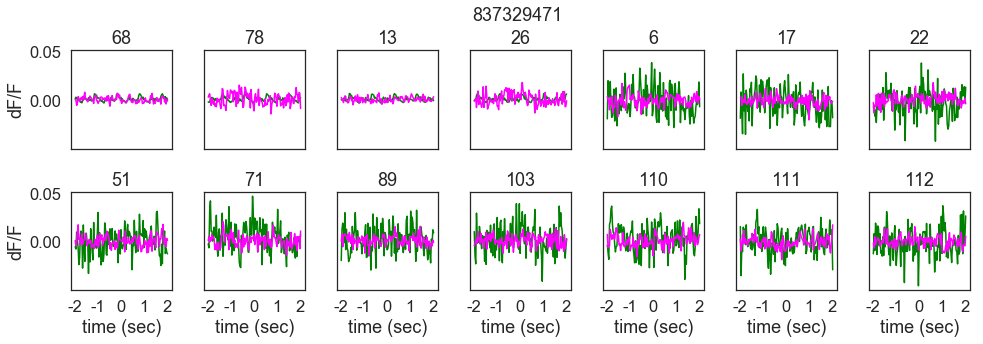

In [94]:
figsize = (14,5)
fig, ax = plt.subplots(2,7,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
for i,image_id in enumerate(images): 
    cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
    mean_trace = cdf.mean_trace.values[0]
    ax[i].plot(mean_trace, color='green', label='oddball block')
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
    mean_trace = tcdf.mean_trace.values[0]
    ax[i].plot(mean_trace, color='magenta', label='transition control block')
    xticks, xticklabels = sf.get_xticks_xticklabels(mean_trace, 31., interval_sec=1)
    ax[i].set_xticks(xticks)
    ax[i].set_xticklabels(xticklabels)
    ax[i].set_title(str(int(image_id)))
ax[0].set_ylabel('dF/F')
ax[7].set_ylabel('dF/F')
for i in range(7,14):
    ax[i].set_xlabel('time (sec)')
fig.tight_layout()
plt.suptitle(str(cell_specimen_id), x=0.525, y=.97, fontsize=18)
plt.subplots_adjust(top=0.85)

KeyboardInterrupt: 

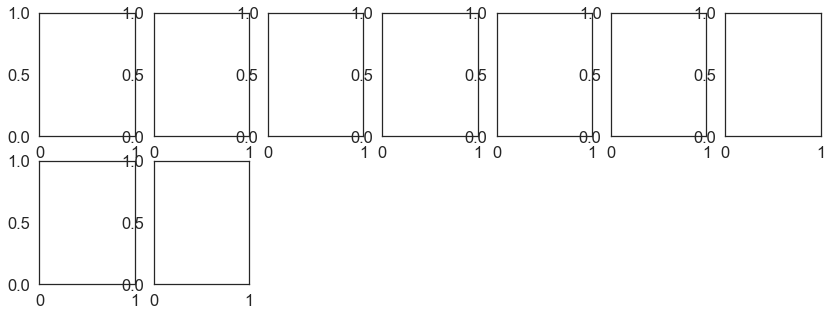

In [95]:
for cell_specimen_id in cell_specimen_ids: 
    figsize = (14,5)
    fig, ax = plt.subplots(2,7,figsize=figsize, sharex=True, sharey=True)
    ax = ax.ravel()
    for i,image_id in enumerate(images): 
        cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
        mean_trace = cdf.mean_trace.values[0]
        ax[i].plot(mean_trace, color='green', label='oddball block')
        tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
        mean_trace = tcdf.mean_trace.values[0]
        ax[i].plot(mean_trace, color='magenta', label='transition control block')
        xticks, xticklabels = sf.get_xticks_xticklabels(mean_trace, 31., interval_sec=1)
        ax[i].set_xticks(xticks)
        ax[i].set_xticklabels(xticklabels)
        ax[i].set_title(str(int(image_id)))
    ax[0].set_ylabel('dF/F')
    ax[7].set_ylabel('dF/F')
    for i in range(7,14):
        ax[i].set_xlabel('time (sec)')
    fig.tight_layout()
    plt.suptitle(str(cell_specimen_id), x=0.525, y=.97, fontsize=18)
    plt.subplots_adjust(top=0.85)
    sf.save_figure(fig, figsize, save_dir, 'oddball_transition_mean_trace', str(cell_specimen_id))
    plt.close()

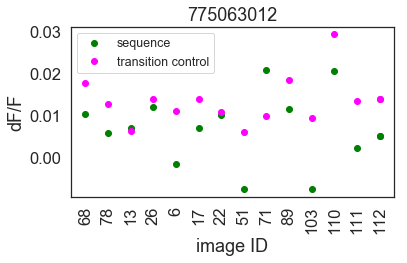

In [76]:
figsize = (6,4)
fig, ax = plt.subplots(figsize=figsize)
for i,image_id in enumerate(images): 
    cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
    mean_response = cdf.mean_response.values[0]
    ax.plot(i, mean_response, 'o', color='green')
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
    mean_response = tcdf.mean_response.values[0]
    ax.plot(i, mean_response, 'o' ,color='magenta')
    
cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
mean_response = cdf.mean_response.values[0]
ax.plot(i, mean_response, 'o', color='green', label='sequence')
tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
mean_response = tcdf.mean_response.values[0]
ax.plot(i, mean_response, 'o' ,color='magenta', label='transition control')

ax.set_title(str(int(cell_specimen_id)))
ax.set_ylabel('dF/F')
ax.set_xticks(np.arange(0,len(images)))
ax.set_xticklabels([int(image) for image in images], rotation=90)
ax.set_xlabel('image ID')
ax.legend(fontsize='x-small')
fig.tight_layout()


In [403]:
for cell_specimen_id in cell_specimen_ids: 
    figsize = (6,4)
    fig, ax = plt.subplots(figsize=figsize)
    for i,image_id in enumerate(images): 
        cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
        mean_response = cdf.mean_response.values[0]
        ax.plot(i, mean_response, 'o', color='green')
        tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
        mean_response = tcdf.mean_response.values[0]
        ax.plot(i, mean_response, 'o' ,color='magenta')

    cdf = odf[(odf.image_id==image_id)&(odf.cell_specimen_id==cell_specimen_id)]
    mean_response = cdf.mean_response.values[0]
    ax.plot(i, mean_response, 'o', color='green', label='sequence')
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
    mean_response = tcdf.mean_response.values[0]
    ax.plot(i, mean_response, 'o' ,color='magenta', label='transition control')

    ax.set_title(str(int(cell_specimen_id)))
    ax.set_ylabel('dF/F')
    ax.set_xticks(np.arange(0,len(images)))
    ax.set_xticklabels([int(image) for image in images], rotation=90)
    ax.set_xlabel('image ID')
    ax.legend(fontsize='x-small')
    fig.tight_layout()
    sf.save_figure(fig, figsize, save_dir, 'oddball_transition_mean_response', str(cell_specimen_id))
    plt.close()

### oddball response metric 

In [97]:
analysis.get_response_df_dict()
o = analysis.response_df_dict['oddball']

loading response dataframe for randomized_control_pre
loading response dataframe for oddball
merging oddball response with stim block
loading oddball block
loading response dataframe for transition_control
loading response dataframe for occlusion
loading response dataframe for natural_movie_one
loading response dataframe for randomized_control_post


In [101]:
t = analysis.response_df_dict['transition_control']

In [100]:
tmp = o[o.cell_index==1]
for image in images: 
    print(image, len(tmp[tmp.image_id==image]))

68.0 2000
78.0 2000
13.0 2000
26.0 1900
6.0 10
17.0 10
22.0 10
51.0 10
71.0 10
89.0 10
103.0 10
110.0 10
111.0 10
112.0 10


In [102]:
tmp = t[t.cell_index==1]
for image in images: 
    print(image, len(tmp[tmp.image_id==image]))

68.0 360
78.0 60
13.0 360
26.0 60
6.0 60
17.0 60
22.0 60
51.0 60
71.0 60
89.0 60
103.0 60
110.0 60
111.0 60
112.0 60


In [182]:
odf = oddball_df.copy()
tdf = transitions_df.copy()

In [183]:
odf = odf.reset_index()
odf = odf.drop(columns=['index'])

In [186]:
odf = odf.reset_index()

oddball_index = []
for index in odf.index.values: 
    row_df = odf.iloc[index]
    cell_specimen_id = row_df.cell_specimen_id
    image_id = row_df.image_id
    oddball_mean_response = row_df.mean_response
    tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
    transitions_mean_response = tcdf.mean_response.values[0]
    oddball_response_index = ((oddball_mean_response-transitions_mean_response)/(oddball_mean_response+transitions_mean_response))
    oddball_index.append(oddball_response_index)
odf['oddball_response_index'] = oddball_index


odf['area'] = odf.targeted_structure.values
odf['depth'] = ['deep' if depth > 250 else 'superficial' for depth in odf.imaging_depth.values]
odf['location'] = None
for row in odf.index: 
    odf.loc[row, 'location'] = odf.iloc[row].area+'_'+odf.iloc[row].depth
    
    
tdf['area'] = tdf.targeted_structure.values
tdf['depth'] = ['deep' if depth > 250 else 'superficial' for depth in tdf.imaging_depth.values]
tdf['location'] = None
for row in tdf.index: 
    tdf.loc[row, 'location'] = tdf.iloc[row].area+'_'+tdf.iloc[row].depth
    
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf.copy()
df = df[df.oddball==True]
# df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='oddball_response_index', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')

Text(0.5, 0, '')

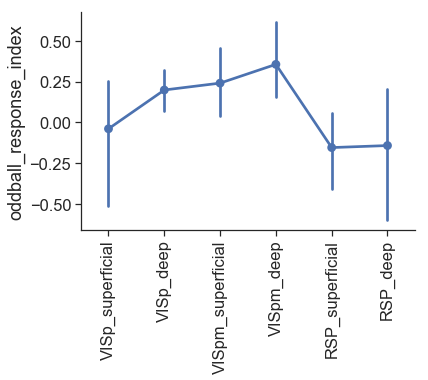

In [380]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf.copy()
df = df[df.oddball==True]
# df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='oddball_response_index', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')

Text(0.5, 0, 'oddball_response_index')

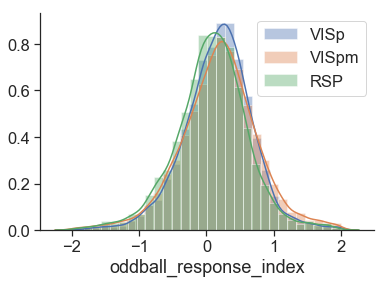

In [399]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

metric = 'oddball_response_index'

df = odf.copy()
df = df[df.oddball==True]
df = df[(df[metric]>-2)&(df[metric]<2)]
# df = df[df.pref_stim==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
for c, area in enumerate(['VISp', 'VISpm', 'RSP']):
    ax = sns.distplot(df[df.area==area][metric].values, bins=30,
                      color=sns.color_palette()[c], ax=ax, label=area)
ax.legend()
ax.set_xlabel(metric)

Text(0.5, 0, '')

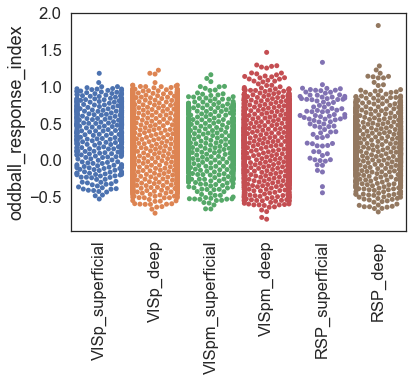

In [222]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf[(odf.oddball_response_index<2)&(odf.oddball_response_index>-2)].copy()
df = df[df.oddball==True]
# df = df[df.fraction_significant_trials>0.2]
df = df[df.mean_response>0.05]
fig, ax = plt.subplots()
ax = sns.swarmplot(data=df, x='location', y='oddball_response_index', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')

### habituated vs novel 

In [ ]:
# # figsize = (6,4)
# # fig, ax = plt.subplots(figsize=figsize)

# oddball_index = []
# for index in odf.index.values: 
#     row_df = odf.iloc[index]
#     cell_specimen_id = row_df.cell_specimen_id
#     image_id = row_df.image_id
#     oddball_mean_response = row_df.mean_response
#     tcdf = tdf[(tdf.image_id==image_id)&(tdf.cell_specimen_id==cell_specimen_id)]
#     habituated_mean_response = tcdf.mean_response.mean()
#     oddball_response_index = ((oddball_mean_response-transitions_mean_response)/(oddball_mean_response+transitions_mean_response))
#     oddball_index.append(oddball_response_index)
# odf['oddball_response_index'] = oddball_index


### mean response across experiments 

In [ ]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

In [104]:
experiment_ids = odf.experiment_id.unique()
experiment_id = experiment_ids[4]

In [338]:
len(experiment_ids)/8

4.25

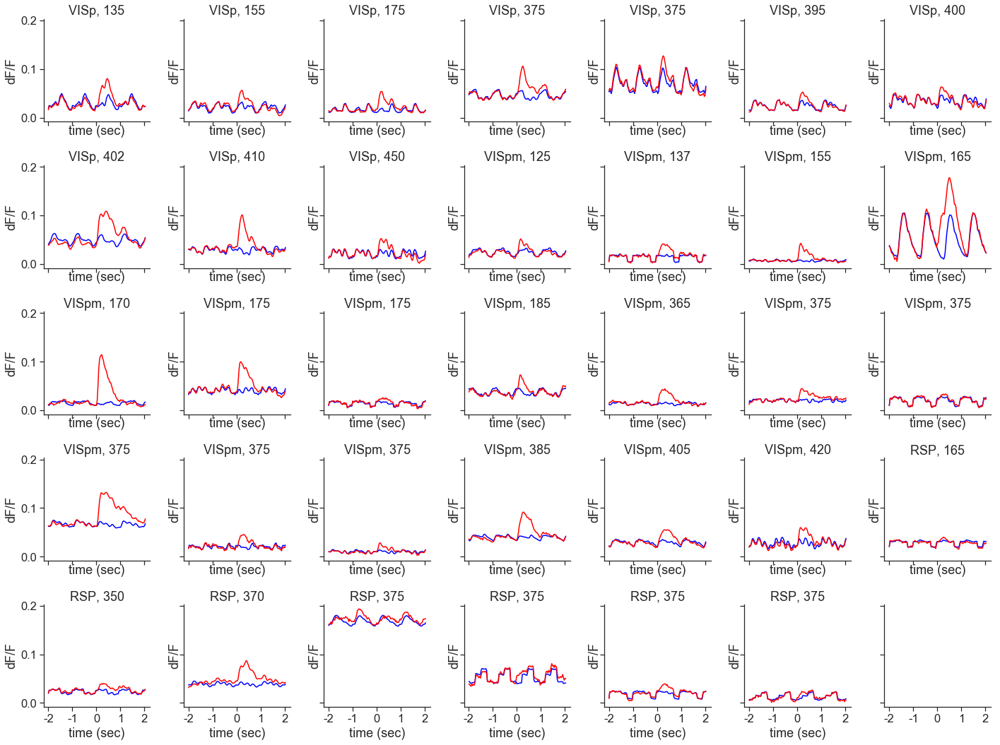

In [341]:
figsize=(20,15)
fig, ax = plt.subplots(5,7,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0
for area in odf.targeted_structure.unique()[::-1]:
    tmp = odf[odf.targeted_structure==area]
    for depth in np.sort(tmp.imaging_depth.unique()):
        tmp2 = tmp[tmp.imaging_depth==depth]
        for experiment_id in tmp2.experiment_id.unique(): 
            edf = odf[odf.experiment_id==experiment_id]   
            sequence = edf[edf.image_id==images[3]].mean_trace.mean()
            oddballs = edf[edf.oddball==True].mean_trace.mean()

            ax[i].plot(sequence, color='blue', label='sequence')
            ax[i].plot(oddballs, color='red', label='oddballs')

            xticks, xticklabels = sf.get_xticks_xticklabels(sequence, 31., interval_sec=1)
            ax[i].set_xticks(xticks)
            ax[i].set_xticklabels([int(x) for x in xticklabels])
            ax[i].set_ylabel('dF/F')
            ax[i].set_xlabel('time (sec)')
            ax[i].set_title(edf.targeted_structure.values[0]+', '+str(edf.imaging_depth.values[0]))
            i+=1
fig.tight_layout()

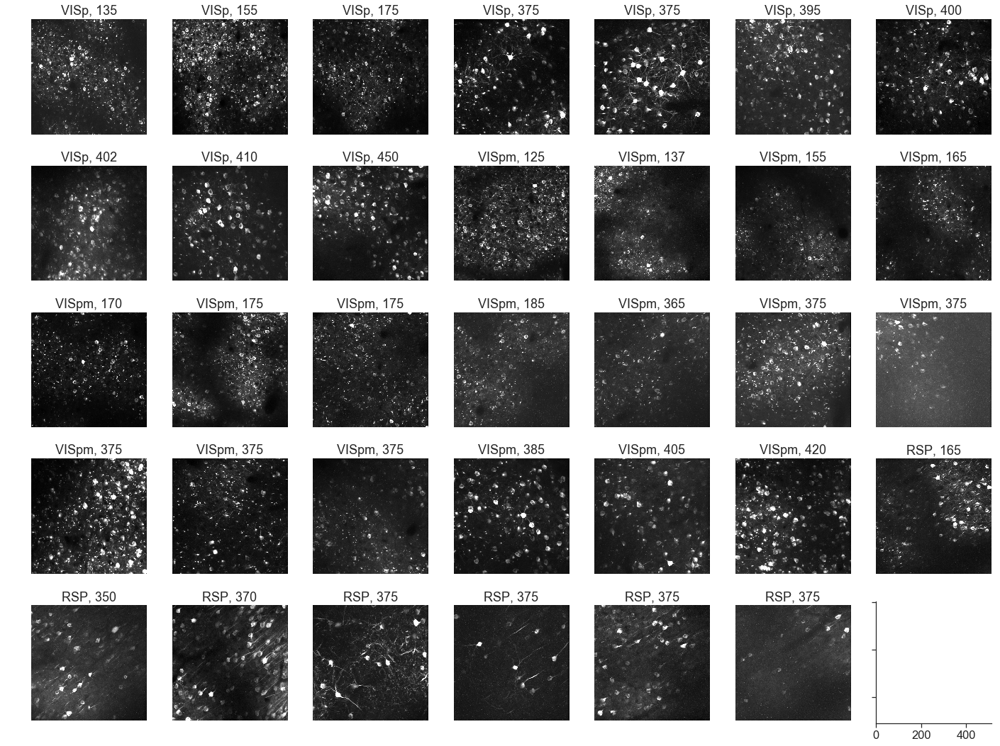

In [401]:
figsize=(20,15)
fig, ax = plt.subplots(5,7,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0
for area in odf.targeted_structure.unique()[::-1]:
    tmp = odf[odf.targeted_structure==area]
    for depth in np.sort(tmp.imaging_depth.unique()):
        tmp2 = tmp[tmp.imaging_depth==depth]
        for experiment_id in tmp2.experiment_id.unique(): 
            dataset = OpenScopePredictiveCodingDataset(experiment_id, cache_dir)

            ax[i].imshow(dataset.max_projection, cmap='gray', vmax=np.amax(dataset.max_projection)/2)
            ax[i].axis('off')
            ax[i].set_title(dataset.metadata.targeted_structure.values[0]+', '+str(dataset.metadata.imaging_depth.values[0]))
            i+=1
fig.tight_layout()

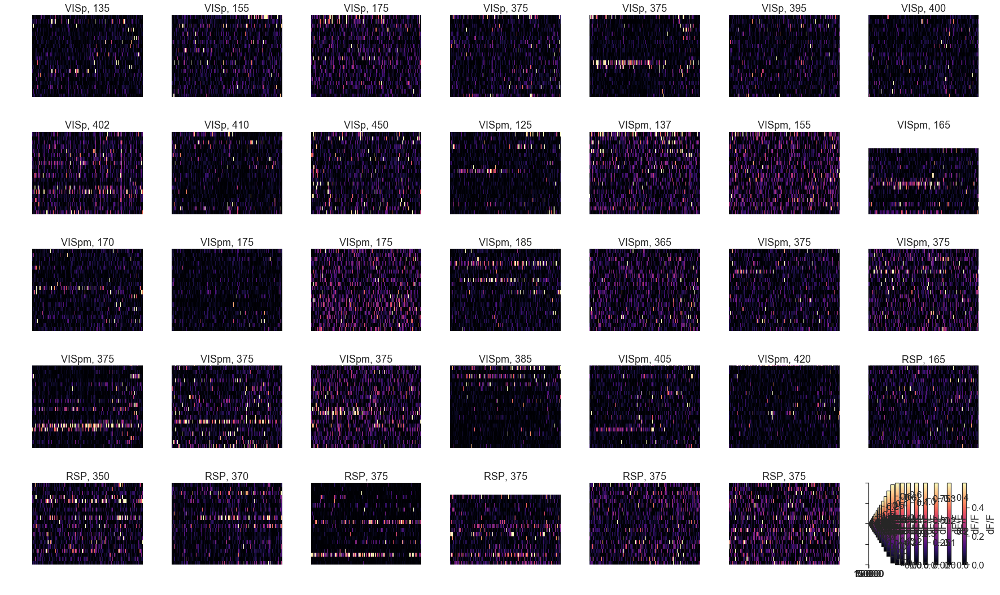

In [365]:
figsize=(25,15)
fig, ax = plt.subplots(5,7,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0
for area in odf.targeted_structure.unique()[::-1]:
    tmp = odf[odf.targeted_structure==area]
    for depth in np.sort(tmp.imaging_depth.unique()):
        tmp2 = tmp[tmp.imaging_depth==depth]
        for experiment_id in tmp2.experiment_id.unique(): 
            dataset = OpenScopePredictiveCodingDataset(experiment_id, cache_dir)
            ax[i] = esf.plot_traces_heatmap(dataset.dff_traces, ax=ax[i], save_dir=None)
            ax[i].axis('off')
            ax[i].set_title(tmp2.targeted_structure.values[0]+', '+str(tmp2.imaging_depth.values[0]))
            i+=1
fig.tight_layout()

In [352]:

def plot_mean_image_response_heatmap(mean_df, image_ids, colorbar=True, title=None, ax=None, save_dir=None):
    df = mean_df.copy()
    images = np.sort(df.image_id.unique())
    images = image_ids
    cell_list = []
    for image in images:
        tmp = df[(df.image_id == image) & (df.pref_stim == True)]
        order = np.argsort(tmp.mean_response.values)[::-1]
        cell_ids = list(tmp.cell_specimen_id.values[order])
        cell_list = cell_list + cell_ids

    response_matrix = np.empty((len(cell_list), len(images)))
    for i, cell_specimen_id in enumerate(cell_list):
        responses = []
        for image in images:
            response = df[(df.cell_specimen_id == cell_specimen_id) & (df.image_id == image)].mean_response.values[0]
            responses.append(response)
        response_matrix[i, :] = np.asarray(responses)

    if ax is None:
        figsize = (5, 8)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.heatmap(response_matrix, cmap='magma', linewidths=0, linecolor='white', square=False,
                     vmin=0, vmax=0.3, robust=True, cbar=colorbar, 
                     cbar_kws={"drawedges": False, "shrink": 1, "label": "mean dF/F"}, ax=ax)

    if title is None:
        title = 'mean response by image'
    ax.set_title(title, va='bottom', ha='center')
    ax.set_xticks(np.arange(0,len(images),1))
    ax.set_xticklabels([int(image) for image in images], rotation=90)
    ax.set_ylabel('cells')
    interval = 10
    ax.set_yticks(np.arange(0, response_matrix.shape[0], interval))
    ax.set_yticklabels(np.arange(0, response_matrix.shape[0], interval))
    if save_dir:
        fig.tight_layout()
        sf.save_figure(fig, figsize, save_dir, 'mean_image_response_heatmap', str(experiment_id)+'_'+title)

    return ax

C:\Anaconda\envs\visual_behavior_sdk\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


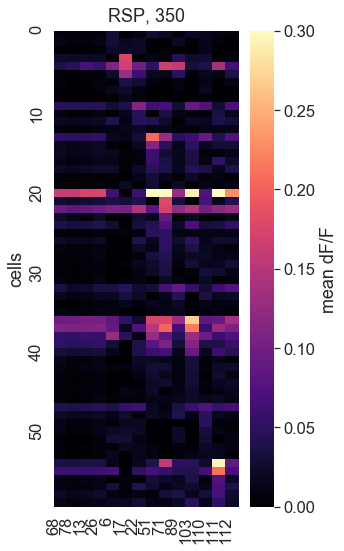

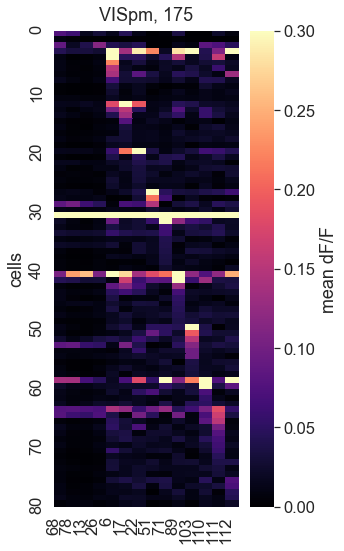

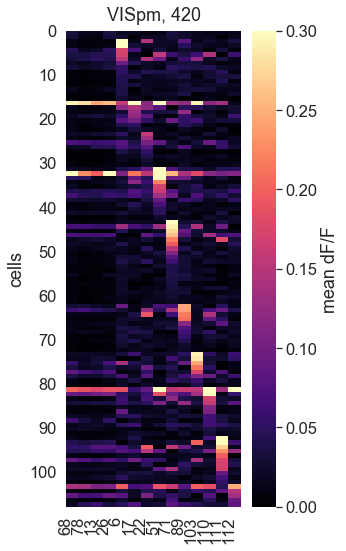

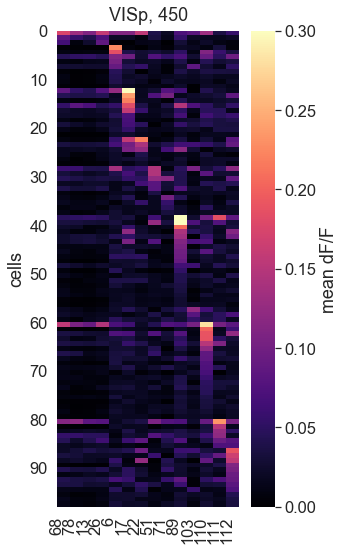

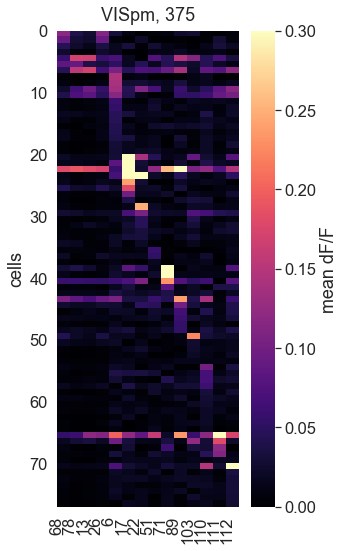

...

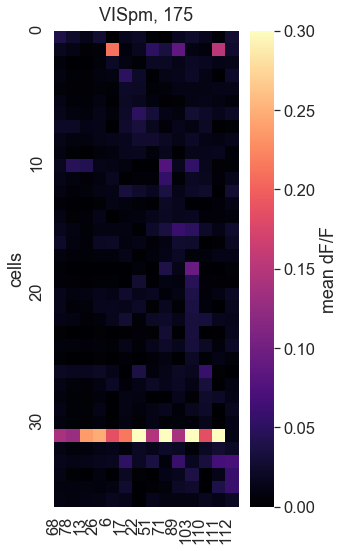

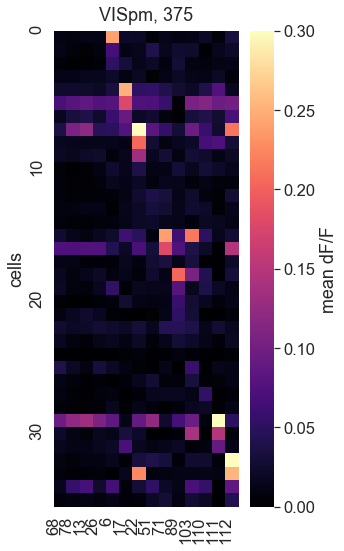

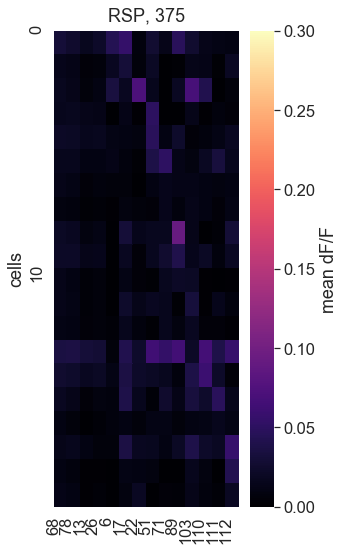

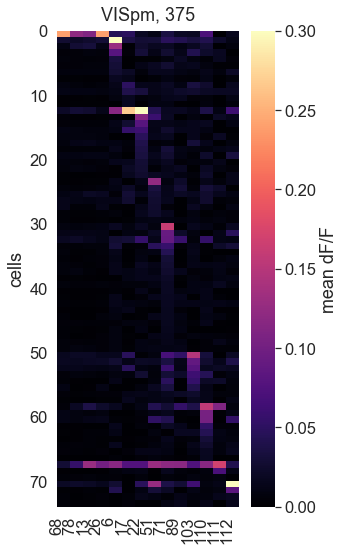

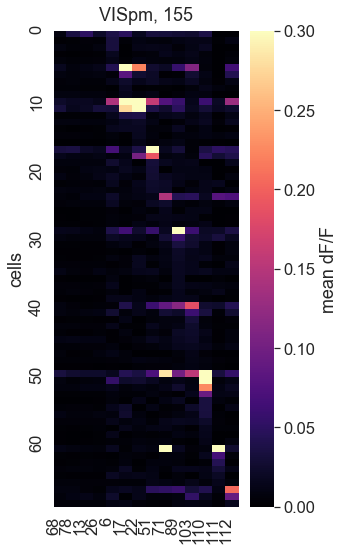

In [123]:
image_ids = analysis.get_image_ids()
for experiment_id in experiment_ids: 
    edf = odf[odf.experiment_id==experiment_id]
    title = edf.targeted_structure.values[0]+', '+str(edf.imaging_depth.values[0])
    plot_mean_image_response_heatmap(edf, image_ids, title=title, ax=None, save_dir=save_dir)

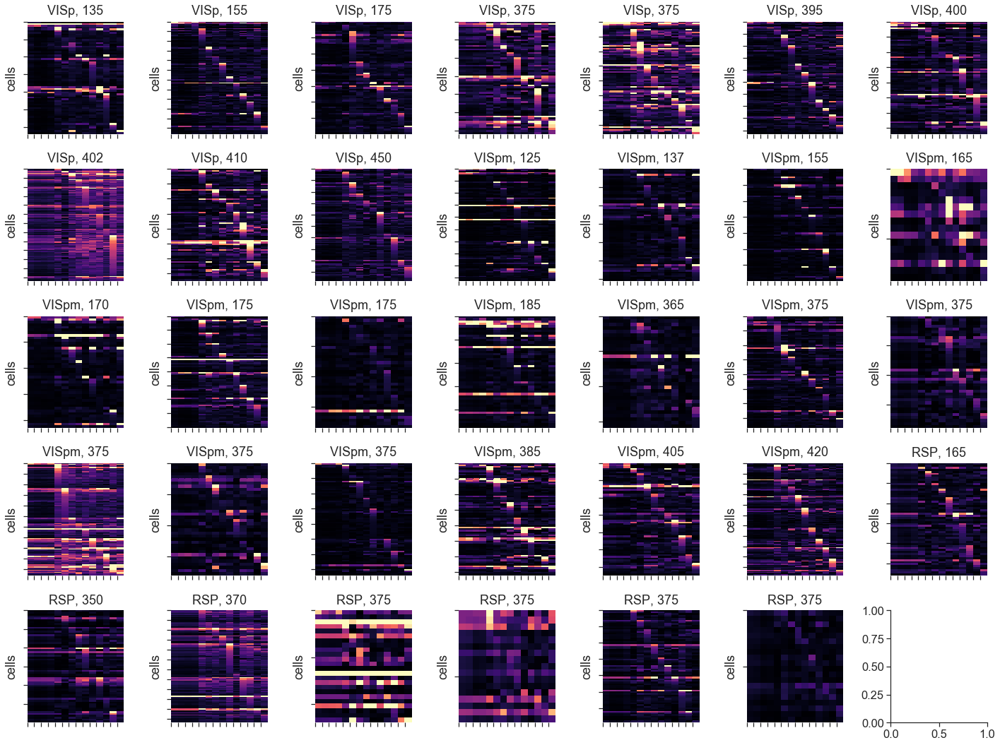

In [353]:
image_ids = analysis.get_image_ids()

figsize=(20,15)
fig, ax = plt.subplots(5,7,figsize=figsize, sharex=False, sharey=False)
ax = ax.ravel()
i=0
for area in odf.targeted_structure.unique()[::-1]:
    tmp = odf[odf.targeted_structure==area]
    for depth in np.sort(tmp.imaging_depth.unique()):
        tmp2 = tmp[tmp.imaging_depth==depth]
        for experiment_id in tmp2.experiment_id.unique(): 
            edf = odf[odf.experiment_id==experiment_id]
            title = edf.targeted_structure.values[0]+', '+str(edf.imaging_depth.values[0])
            ax[i] = plot_mean_image_response_heatmap(edf, image_ids, colorbar=False, title=title, ax=ax[i], save_dir=None)
            ax[i].set_xlabel('')
            ax[i].set_xticklabels('')
            ax[i].set_yticklabels('')
            ax[i].set_ylabel('')
            i+=1
fig.tight_layout()

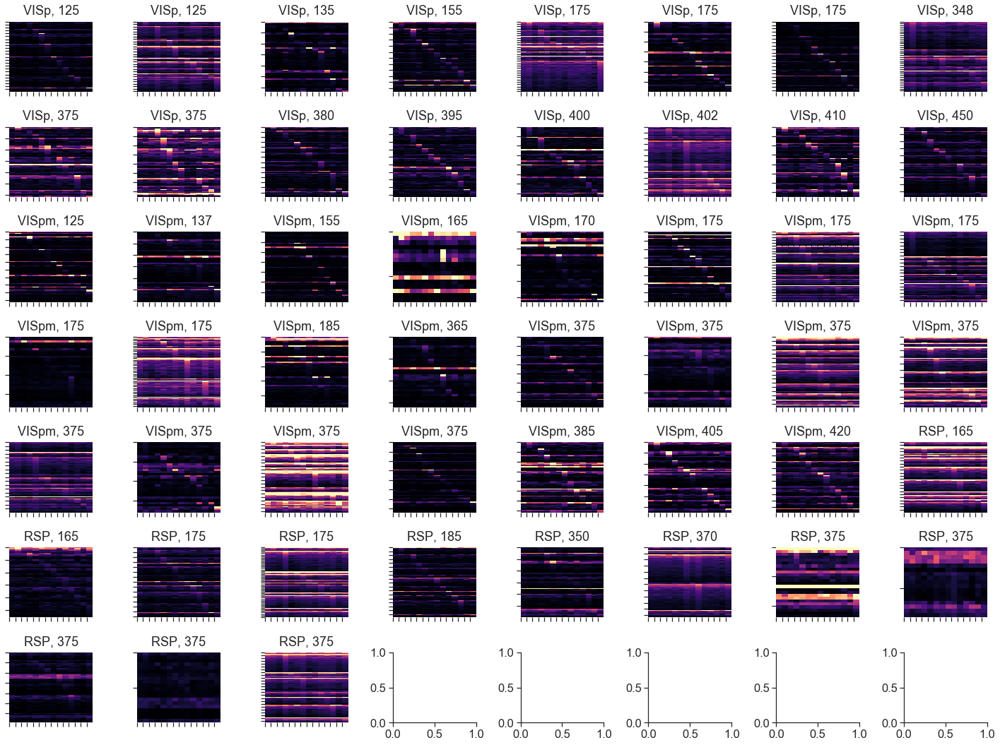

In [402]:
image_ids = analysis.get_image_ids()

figsize=(20,15)
fig, ax = plt.subplots(7,8,figsize=figsize, sharex=False, sharey=False)
ax = ax.ravel()
i=0
for area in tdf.targeted_structure.unique()[::-1]:
    tmp = tdf[tdf.targeted_structure==area]
    for depth in np.sort(tmp.imaging_depth.unique()):
        tmp2 = tmp[tmp.imaging_depth==depth]
        for experiment_id in tmp2.experiment_id.unique(): 
            edf = tdf[tdf.experiment_id==experiment_id]
            title = edf.targeted_structure.values[0]+', '+str(edf.imaging_depth.values[0])
            ax[i] = plot_mean_image_response_heatmap(edf, image_ids, colorbar=False, title=title, ax=ax[i], save_dir=None)
            ax[i].set_xlabel('')
            ax[i].set_xticklabels('')
            ax[i].set_yticklabels('')
            ax[i].set_ylabel('')
            i+=1
fig.tight_layout()

Text(0.5, 1.0, 'response magnitude during sequence block')

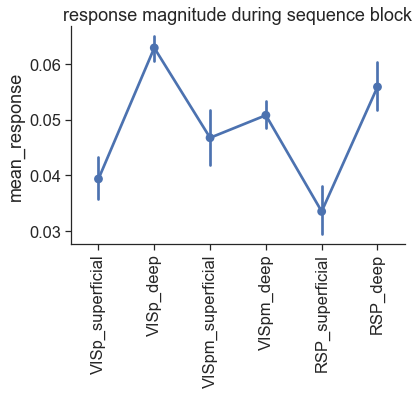

In [360]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf.copy()
df = df[df.oddball==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='mean_response', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.set_title('response magnitude during sequence block')

Text(0.5, 1.0, 'response magnitude during transition control')

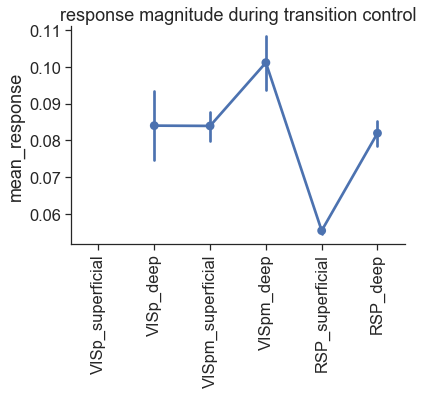

In [366]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = tdf.copy()
df = df[df.oddball==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='mean_response', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.set_title('response magnitude during transition control')

Text(0.5, 1.0, 'reliability during sequence block')

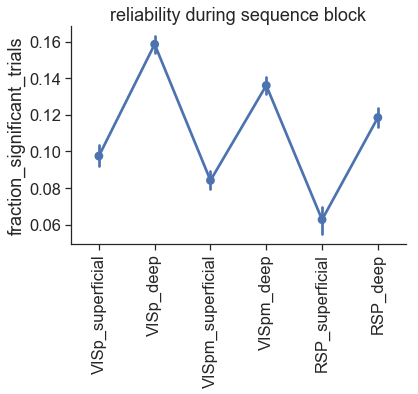

In [367]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = odf.copy()
df = df[df.oddball==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='fraction_significant_trials', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.set_title('reliability during sequence block')

Text(0.5, 1.0, 'reliability during transition control')

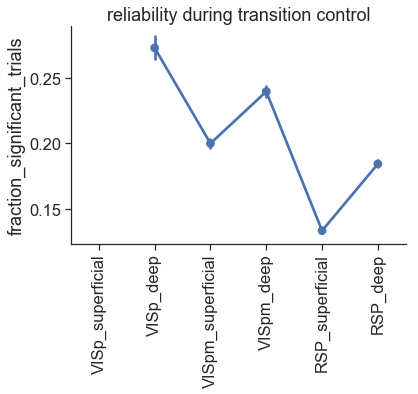

In [369]:
locations = ['VISp_superficial', 'VISp_deep', 'VISpm_superficial', 'VISpm_deep', 'RSP_superficial', 'RSP_deep']

df = tdf.copy()
df = df[df.oddball==True]
# df = df[df.mean_response>0.05]
# df = df[df.fraction_significant_trials>0.0]

fig, ax = plt.subplots()
ax = sns.pointplot(data=df, x='location', y='fraction_significant_trials', order=locations, ax=ax)
ax.set_xticklabels(locations, rotation=90)
ax.set_xlabel('')
ax.set_title('reliability during transition control')

### image responsiveness

In [293]:
def get_session_summary_df(fdf, use_events=False):
    # only consider responses to preferred stimulus
    df = fdf[fdf.pref_stim==True].copy() 
    summary_data = []
    for experiment_id in df.experiment_id.unique():
        expt = df[(df.experiment_id == experiment_id)]
        area = expt.targeted_structure.unique()[0]
        if 'location' in fdf.keys():
            location = expt.location.unique()[0]
        else: 
            lcation = None
        cre_line = expt.cre_line.unique()[0]
        mouse_id = expt.donor_id.unique()[0]
        depth = expt.imaging_depth.unique()[0]
        session_type = expt.session_type.unique()[0]
        image_set = expt.image_set.unique()[0]
        experiment_date = expt.experiment_date.unique()[0]
        n_cells = len(expt.cell_specimen_id.unique())
        summary_data.append(
            [experiment_id, mouse_id, session_type, image_set, area, location, cre_line, experiment_date, depth, n_cells])

    columns = ['experiment_id', 'mouse_id', 'session_type','image_set', 'area', 'location', 'cre_line', 
               'experiment_date', 'depth', 'n_cells']
    session_summary_df = pd.DataFrame(data=summary_data, columns=columns)
    return session_summary_df

def add_metric_to_session_summary_df(metric, data, session_summary_df):
    df = data.copy()
    session_summary_df[metric] = None
    for experiment_id in session_summary_df.experiment_id.unique(): 
        metric_values = df[(df.experiment_id==experiment_id)][metric].values
        session_mean = np.nanmean(metric_values)
        idx = session_summary_df[(session_summary_df.experiment_id==experiment_id)].index[0]
        session_summary_df.loc[idx, metric] = session_mean
    return session_summary_df

In [294]:
odf['image_set'] = 'A'
session_summary_df = get_session_summary_df(odf)
session_summary_df

,experiment_id,mouse_id,session_type,image_set,area,location,cre_line,experiment_date,depth,n_cells
0,775058863,416366,behavior_session_2,A,RSP,RSP_deep,Slc17a7,2018-11-07,350,60
1,775613721,416366,behavior_session_3,A,VISpm,VISpm_superficial,Slc17a7,2018-11-08,175,81
2,776727982,416366,behavior_session_4,A,VISpm,VISpm_deep,Slc17a7,2018-11-09,420,108
3,813071318,432373,behavior_session_2,A,VISp,VISp_deep,Slc17a7,2019-01-24,450,98
4,816795279,432373,behavior_session_4,A,VISpm,VISpm_deep,Slc17a7,2019-01-31,375,77
5,818894752,432373,behavior_session_6,A,VISpm,VISpm_superficial,Slc17a7,2019-02-05,125,93
6,826576489,433242,behavior_session_1,A,VISp,VISp_superficial,Slc17a7,2019-02-20,135,64
7,827232898,433242,behavior_session_2,A,VISp,VISp_deep,Slc17a7,2019-02-21,410,75
8,828956958,433242,behavior_session_4,A,VISpm,VISpm_superficial,Slc17a7,2019-02-25,170,43
9,829411383,433242,behavior_session_5,A,VISpm,VISpm_deep,Slc17a7,2019-02-26,385,72


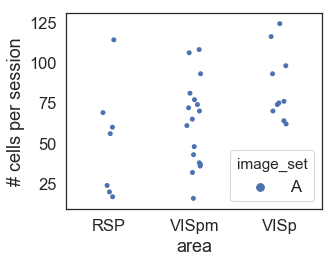

In [295]:
df = session_summary_df.copy()
figsize = (5,4)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.stripplot(data=df, x='area', y='n_cells', hue='image_set', ax = ax, dodge=True)
ax.set_ylabel('# cells per session')
fig.tight_layout()
sf.save_figure(fig, figsize, save_dir, 'session_numbers', 'n_cells_by_image_set')

In [296]:
def adjust_box_widths(ax, fac):
    from matplotlib.patches import PathPatch
    # Adjust the withs of a seaborn-generated boxplot.
    for c in ax.get_children():
        if isinstance(c, PathPatch):
            p = c.get_path()
            verts = p.vertices
            verts_sub = verts[:-1]
            xmin = np.min(verts_sub[:, 0])
            xmax = np.max(verts_sub[:, 0])
            xmid = 0.5 * (xmin + xmax)
            xhalf = 0.5 * (xmax - xmin)
            xmin_new = xmid - fac * xhalf
            xmax_new = xmid + fac * xhalf
            verts_sub[verts_sub[:, 0] == xmin, 0] = xmin_new
            verts_sub[verts_sub[:, 0] == xmax, 0] = xmax_new
            for l in ax.lines:
                if np.all(l.get_xdata() == [xmin, xmax]):
                    l.set_xdata([xmin_new, xmax_new])


def plot_boxplot_for_condition(df, metric, condition='image_set', condition_values=['A', 'B', 'C', 'D'],
                               colors=sns.color_palette(), hue='cre_line', ylabel=None, 
                               range=(0, 1), ax=None, save_figures=False, save_dir=None, folder=None):
    if ax is None:
        figsize = (4.5, 4.5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.boxplot(data=df, x=condition, y=metric,
                     hue=hue, ax=ax, width=0.4, dodge=True, palette=colors)
    if ylabel is None:
        ax.set_ylabel('fraction of cells per session')
    else:
        ax.set_ylabel(ylabel)
    ax.set_ylim(range[0] - 0.05, range[1] + .05)
    ax.get_legend().remove()
    ax.set_title(metric)
    sns.despine(offset=10, trim=True)
    plt.gcf().subplots_adjust(top=0.85)
    plt.gcf().subplots_adjust(left=0.25)
    plt.gcf().subplots_adjust(right=0.85)
    plt.gcf().subplots_adjust(bottom=0.25)
    if save_figures:
        psf.save_figure(fig, figsize, save_dir, folder, metric + '_by_' + condition + '_box')
    return ax

In [297]:
def plot_boxplot_and_swarm_for_condition(df, metric, condition='cre_line', condition_values=None,
                                         colors=sns.color_palette(), hue='image_set', hue_order=None, order=None, ylabel=None, xlabel=None, title=None,
                                         plot_swarm=True, show_stats=True, range=(0,1), ax=None, save_figures=False, save_dir=None, folder=None, suffix=''):
    df[metric] = pd.to_numeric(df[metric])
    if hue_order is None: 
        hue_order = np.sort(df[hue].unique())
    if ax is None:
        figsize = (4.5,4.5)
        fig,ax = plt.subplots(figsize=figsize)
    if order is None: 
        order = condition_values
    ax = sns.boxplot(data=df, x=condition, y=metric, hue_order=hue_order, order=order,
                 hue=hue, ax=ax, dodge=True, palette=colors) #color='white',
    adjust_box_widths(ax, 0.8)
    if plot_swarm:
        ax = sns.swarmplot(data=df, x=condition, y=metric, order=order,
                      size=3, ax=ax, hue=hue, hue_order=hue_order, color='.3', dodge=True) #palette=colors,
        swarm_cols = ax.collections
        for swarm in swarm_cols:
            swarm.set_facecolors([0.6,0.6,0.6])

    if ylabel is None:
        ax.set_ylabel('fraction of cells per session')
    else:
        ax.set_ylabel(ylabel)
    if xlabel is None:
        if len(condition.split('_'))>1: 
            ax.set_xlabel(condition.split('_')[0]+' '+condition.split('_')[1])
        else: 
            ax.set_xlabel(condition)
    else:
        ax.set_xlabel(xlabel)
    ax.set_xticklabels(condition_values, rotation=90)
    if title is None:
        ax.set_title(metric)
    else:
        ax.set_title(title)
    ax.set_ylim(range[0]-0.05,range[1]+.05)
    ax.get_legend().remove()
    sns.despine(offset=10, trim=True)
    
    if show_stats: 
        hue_names = hue_order
        sig_y_val = df[metric].max()
        
        stats_df = get_stats_for_conditions(df, metric, condition, condition_values, hue, hue_names)
        label_df = get_label_df(ax, stats_df, condition, condition_values, hue, hue_names)
        ax = label_ax_with_stats(ax, label_df, stats_df, sig_y_val, condition, condition_values, hue, hue_names)
    
    ax.set_ylim(range[0]-0.05,range[1]+.05)
    plt.gcf().subplots_adjust(top=0.85)
    plt.gcf().subplots_adjust(left=0.25)
    plt.gcf().subplots_adjust(right=0.85)
    plt.gcf().subplots_adjust(bottom=0.25)
    if save_figures:
#         l = ax.legend(title=condition, fontsize='small')
#         plt.setp(l.get_title(),fontsize='small')
        sf.save_figure(fig ,figsize, save_dir, folder, metric+'_by_'+condition+'_box_swarm'+suffix)

    return ax

In [298]:
df = odf.copy()
df = df[df.pref_stim==True]
metric = 'fraction_significant_trials'
fraction_responsive_list = []
for experiment_id in session_summary_df.experiment_id.unique():
    expt = df[(df.experiment_id == experiment_id)]
    n_cells = len(expt.cell_specimen_id.unique())
    if np.isnan(expt.fraction_significant_trials.values[0])==False: #if has omitted
        n_responsive = len(expt[expt.fraction_significant_trials>0.25])
    else: 
        n_responsive = np.nan
    fraction = n_responsive / float(n_cells)
    fraction_responsive_list.append(fraction)

session_summary_df['fraction_responsive_'+metric] = fraction_responsive_list

In [405]:
session_summary_df['fraction_responsive_oddball'] = session_summary_df.fraction_responsive_fraction_significant_trials.values

In [406]:
areas = ['VISp', 'VISpm', 'RSP']

C:\Anaconda\envs\visual_behavior_sdk\lib\site-packages\ipykernel_launcher.py:18: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


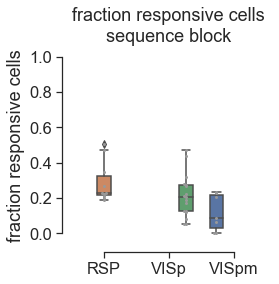

In [408]:
metric = 'fraction_responsive_oddball'
xlabel = ''
title = 'fraction responsive cells\nsequence block'
ylabel = 'fraction responsive cells'

hue = 'area'
hue_order = np.sort(session_summary_df.area.unique())
colors = sns.color_palette()

df = session_summary_df.copy()
df[metric] = pd.to_numeric(df[metric])

#     df['cre line'] = [cre_line.split('-')[0] for cre_line in df.cre_line.values]
condition = 'area'
condition_values = np.sort(df['area'].unique())

plot_boxplot_and_swarm_for_condition(df, metric, condition, condition_values, colors, hue, hue_order=hue_order,
                                     plot_swarm=True, ylabel=ylabel, xlabel=xlabel, title=title, range=(0,1), ax=None, 
                                     order=areas, suffix='', save_figures=True, save_dir=save_dir, folder='fraction_responsive', 
                                     show_stats=False)


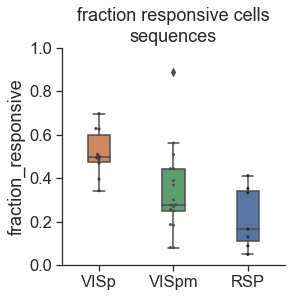

In [409]:
metric = 'fraction_responsive'
xlabel = ''
title = 'fraction responsive cells\nsequences'
ylabel = 'fraction responsive cells'

hue = 'area'
hue_order = np.sort(session_summary_df.area.unique())
colors = sns.color_palette()

df = session_summary_df.copy()
df[metric] = pd.to_numeric(df[metric])

#     df['cre line'] = [cre_line.split('-')[0] for cre_line in df.cre_line.values]
condition = 'area'
condition_values = np.sort(df['area'].unique())
order = areas

fig, ax = plt.subplots(figsize=(4,4))
ax = sns.boxplot(data=df, x=condition, y=metric, hue_order=hue_order, order=order,
                 hue=hue, ax=ax, dodge=False, palette=colors, width=0.3) #color='white',

ax = sns.swarmplot(data=df, x=condition, y=metric, order=order,
                  size=3, ax=ax, hue=hue, hue_order=hue_order, color='.3', dodge=False) #palette=colors,

ax.legend_.remove()
ax.set_ylim(0,1)
ax.set_xlabel('')
ax.set_title(title)
sns.despine()

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

Text(0, 0.5, '')

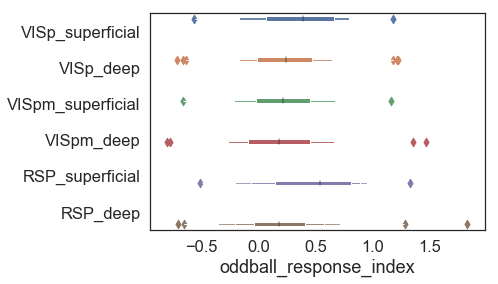

In [309]:
metric = 'oddball_response_index'
xlabel = ''
title = 'oddball response index'
ylabel = title

hue = 'location'
hue_order = locations
colors = sns.color_palette()
order = locations

df = odf.copy()
df[metric] = pd.to_numeric(df[metric])
df = df[(df[metric]<2)&(df[metric]>-2)]
df = df[df.mean_response>0.05]
                       
#     df['cre line'] = [cre_line.split('-')[0] for cre_line in df.cre_line.values]
condition = 'location'
condition_values = np.sort(df['location'].unique())

fig, ax = plt.subplots()

ax = sns.boxenplot(data=df, y=condition, x=metric, hue_order=hue_order, order=order,
                 hue=hue, ax=ax, dodge=True, palette=colors, orient='h') #color='white',

ax.legend_.remove()
ax.set_ylabel('')
# plot_boxplot_and_swarm_for_condition(df, metric, condition, condition_values, colors, hue, hue_order=hue_order,
#                                      order=None, plot_swarm=False, ylabel=ylabel, xlabel=xlabel, title=title, range=(-2,2), ax=None, 
#                                      suffix='', save_figures=True, save_dir=save_dir, folder='fraction_responsive', 
#                                      show_stats=False)


### fraction responsive across stimulus types

In [358]:
analysis.response_df_dict.keys()

dict_keys(['randomized_control_pre', 'oddball', 'transition_control', 'occlusion', 'natural_movie_one', 'randomized_control_post'])

In [371]:
df = tdf.copy()
df = df[df.pref_stim==True]
metric = 'fraction_significant_trials'
fraction_responsive_list = []
for experiment_id in session_summary_df.experiment_id.unique():
    expt = df[(df.experiment_id == experiment_id)]
    n_cells = len(expt.cell_specimen_id.unique())
    if np.isnan(expt.fraction_significant_trials.values[0])==False: #if has omitted
        n_responsive = len(expt[expt.fraction_significant_trials>0.25])
    else: 
        n_responsive = np.nan
    fraction = n_responsive / float(n_cells)
    fraction_responsive_list.append(fraction)

session_summary_df['fraction_responsive_'+metric] = fraction_responsive_list

In [375]:
session_summary_df['fraction_responsive_transition'] = session_summary_df.fraction_responsive_fraction_significant_trials.values

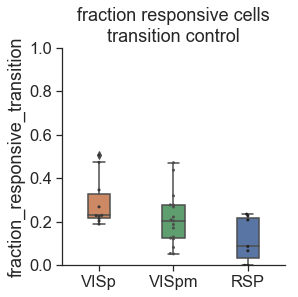

In [376]:
metric = 'fraction_responsive_transition'
xlabel = ''
title = 'fraction responsive cells\ntransition control'
ylabel = 'fraction responsive cells'

hue = 'area'
hue_order = np.sort(session_summary_df.area.unique())
colors = sns.color_palette()

df = session_summary_df.copy()
df[metric] = pd.to_numeric(df[metric])

#     df['cre line'] = [cre_line.split('-')[0] for cre_line in df.cre_line.values]
condition = 'area'
condition_values = np.sort(df['area'].unique())
order = areas

fig, ax = plt.subplots(figsize=(4,4))
ax = sns.boxplot(data=df, x=condition, y=metric, hue_order=hue_order, order=order,
                 hue=hue, ax=ax, dodge=False, palette=colors, width=0.3) #color='white',

ax = sns.swarmplot(data=df, x=condition, y=metric, order=order,
                  size=3, ax=ax, hue=hue, hue_order=hue_order, color='.3', dodge=False) #palette=colors,

ax.legend_.remove()
ax.set_ylim(0,1)
ax.set_xlabel('')
ax.set_title(title)
sns.despine()

### images

In [412]:
images

[68.0,
 78.0,
 13.0,
 26.0,
 6.0,
 17.0,
 22.0,
 51.0,
 71.0,
 89.0,
 103.0,
 110.0,
 111.0,
 112.0]

In [423]:
st.keys()

Index(['index', 'sweep', 'start_frame', 'end_frame_inclusive', 'start_time',
       'end_time', 'session_block_name', 'image_id', 'repeat',
       'fraction_occlusion', 'duration', 'session_type', 'stimulus_key',
       'data_file_index', 'data_file_name', 'frame_list'],
      dtype='object')

### occlusion

In [460]:
np.sort(st[st.session_block_name=='occlusion'].fraction_occlusion.unique())

array([0.  , 0.15, 0.3 , 0.4 , 0.5 , 0.6 ])

In [458]:
st.keys()

Index(['index', 'sweep', 'start_frame', 'end_frame_inclusive', 'start_time',
       'end_time', 'session_block_name', 'image_id', 'repeat',
       'fraction_occlusion', 'duration', 'session_type', 'stimulus_key',
       'data_file_index', 'data_file_name', 'frame_list'],
      dtype='object')

In [461]:
st = dataset.stimulus_table
st = st[st.session_block_name=='occlusion']
occlusion_images = st[st.session_block_name=='occlusion'].image_id.unique()
occlusion_fractions = np.sort(st[st.session_block_name=='occlusion'].fraction_occlusion.unique())
image_dict = {}
for image_id in occlusion_images: 
    image_dict[image_id] = {}
    for fraction_occlusion in occlusion_fractions:
        file_name = st[(st.image_id==image_id)&(st.fraction_occlusion==fraction_occlusion)].iloc[0].data_file_name
        file_index = st[(st.image_id==image_id)&(st.fraction_occlusion==fraction_occlusion)].iloc[0].data_file_index
        print(file_name, file_index)
        image_data = np.load(file_name)
        print(image_data.shape)
        image_dict[image_id,fraction_occlusion] = image_data[file_index, :,:]

//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 40
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 0
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 10
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 132
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 92
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 74
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 1
(600, 600, 960)
//allen/aibs/technology/nicholasc/openscope/ophys_pilot_occlusion_659b61b30d270bb849a7c4a903125e02.npy 126
(600, 600, 960)
//allen/aibs/technology/

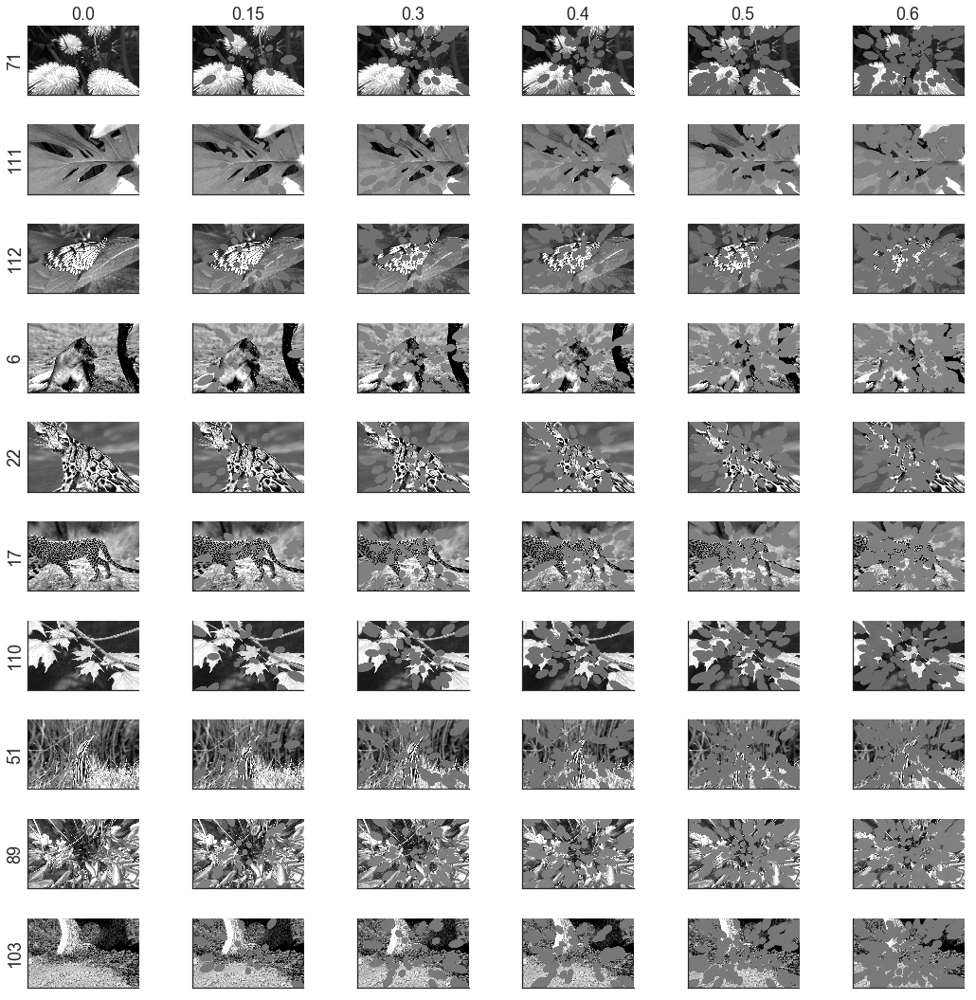

In [479]:
figsize = (15,15)
fig, ax = plt.subplots(10,6,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0
for y, image_id in enumerate(occlusion_images): 
    for fraction_occlusion in occlusion_fractions:
        ax[i].axes.get_xaxis().set_ticks([])
        ax[i].axes.get_yaxis().set_ticks([])
        ax[i].imshow(image_dict[image_id, fraction_occlusion], cmap='gray')
        if y == 0:
            ax[i].set_title(str(fraction_occlusion))
#         ax[i].axis('off')
        ax[i].set_xticklabels('')
        ax[i].set_yticklabels('')
        if fraction_occlusion == 0: 
            ax[i].set_ylabel(int(image_id))
        i+=1
fig.tight_layout()

### oddball

In [428]:
st = dataset.stimulus_table
st = st[st.session_block_name=='oddball']
image_dict = {}
for image_id in images: 
    file_name = st[st.image_id==image_id].iloc[0].data_file_name
    file_index = st[st.image_id==image_id].iloc[0].data_file_index
    print(file_name, file_index)
    image_data = np.load(file_name)
    print(image_data.shape)
    image_dict[image_id] = image_data[file_index, :,:]

//allen/aibs/technology/nicholasc/openscope/68_78_13_26_2950e8d1e5187ce65ac40f5381be0b3f.npy 0
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_26_2950e8d1e5187ce65ac40f5381be0b3f.npy 1
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_26_2950e8d1e5187ce65ac40f5381be0b3f.npy 2
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_26_2950e8d1e5187ce65ac40f5381be0b3f.npy 3
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_6_e7c9e5b69add976b510ee8e85fc9a451.npy 3
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_17_b4466dd964710092bbbce1a5c62acd38.npy 3
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_22_eb69aeef83b4852217df8f8a2eb529c7.npy 3
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_51_b8b6a093ff7955ea8fd2cb48bd5ffa3c.npy 3
(4, 600, 960)
//allen/aibs/technology/nicholasc/openscope/68_78_13_71_59880b3ff357998b5fac5b79b60c1e92.npy 3
(4, 600, 960)
//allen/aibs/technol

In [429]:
image_dict[112].shape

(600, 960)

(-0.5, 959.5, 599.5, -0.5)

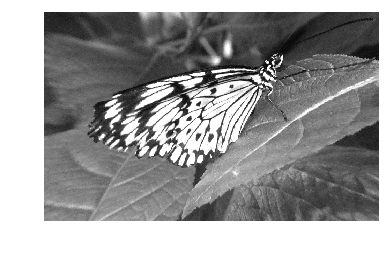

In [433]:
plt.imshow(image_dict[112], cmap='gray')
plt.axis('off')

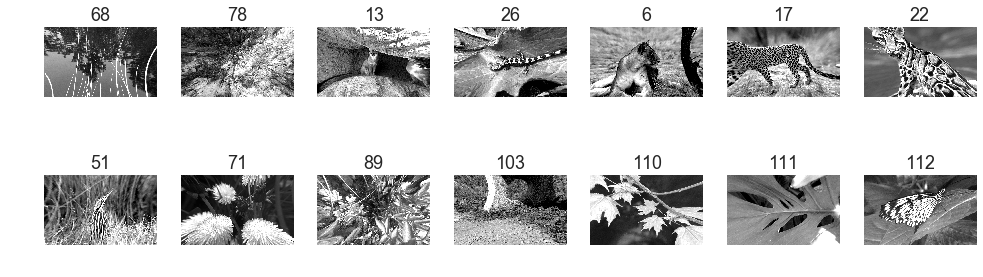

In [434]:
figsize = (14,5)
fig, ax = plt.subplots(2,7,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
for i,image_id in enumerate(images): 
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
fig.tight_layout()

In [436]:
analysis.get_sequence_images()[:2]

[68.0, 78.0]

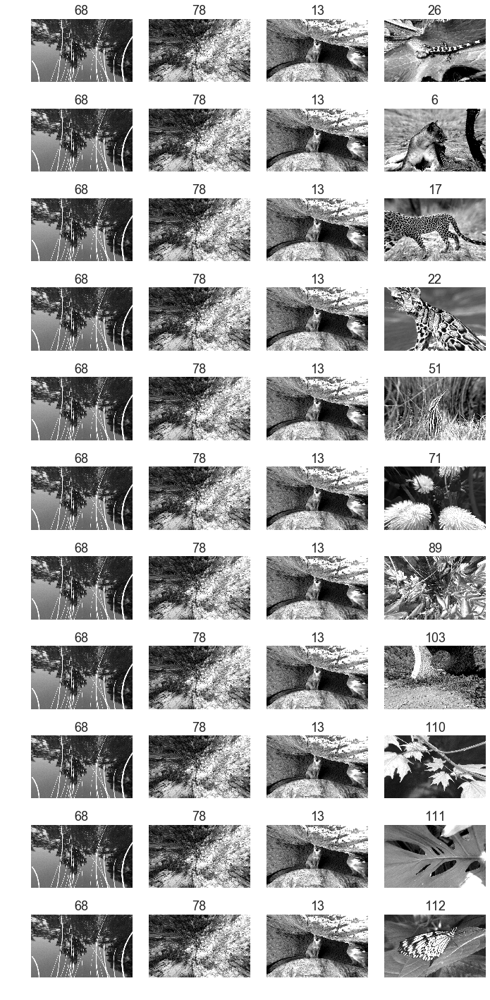

In [439]:
figsize = (10,20)
fig, ax = plt.subplots(11,4,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0
for x, image_id in enumerate(analysis.get_sequence_images()):
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
    i+=1
for x,oddball_id in enumerate(analysis.get_oddball_images()):
    for x, image_id in enumerate(analysis.get_sequence_images()[:3]):
        ax[i].imshow(image_dict[image_id], cmap='gray')
        ax[i].set_title(str(int(image_id)))
        ax[i].axis('off')
        i+=1
    ax[i].imshow(image_dict[oddball_id], cmap='gray')
    ax[i].set_title(str(int(oddball_id)))
    ax[i].axis('off')
    i+=1
fig.tight_layout()

#### transition control

In [444]:
analysis.get_sequence_images()[2]

13.0

In [446]:
analysis.get_sequence_images()[:1]

[68.0]

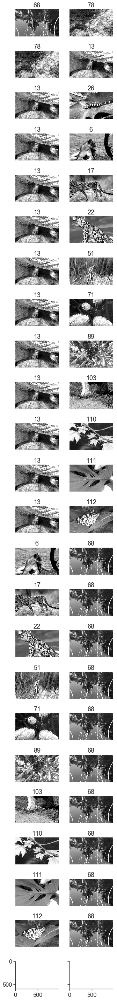

In [450]:
figsize = (5,40)
fig, ax = plt.subplots(24,2,figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()
i=0
for x, image_id in enumerate(analysis.get_sequence_images()[:2]):
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
    i+=1
for x, image_id in enumerate(analysis.get_sequence_images()[1:3]):
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
    i+=1
for x, image_id in enumerate(analysis.get_sequence_images()[2:]):
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
    i+=1
for x,oddball_id in enumerate(analysis.get_oddball_images()):
    image_id = analysis.get_sequence_images()[2]
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
    i+=1
    ax[i].imshow(image_dict[oddball_id], cmap='gray')
    ax[i].set_title(str(int(oddball_id)))
    ax[i].axis('off')
    i+=1
for x,oddball_id in enumerate(analysis.get_oddball_images()):
    ax[i].imshow(image_dict[oddball_id], cmap='gray')
    ax[i].set_title(str(int(oddball_id)))
    ax[i].axis('off')
    i+=1
    image_id = analysis.get_sequence_images()[0]
    ax[i].imshow(image_dict[image_id], cmap='gray')
    ax[i].set_title(str(int(image_id)))
    ax[i].axis('off')
    i+=1
fig.tight_layout()